# COCO Dataset

In [1]:
import sys
sys.path.append('../../')

%load_ext autoreload
%autoreload 2

from dl.data.text import augmentations
from dl.data.text import datasets, target_transforms, transforms

In [2]:
augmentation = None

transform = transforms.Compose(
    [transforms.ToTensor(),
     #transforms.Normalize(rgb_means=(0.485, 0.456, 0.406), rgb_stds=(0.229, 0.224, 0.225))]
    ]
)
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.COCO2014Text_Dataset(ignore=target_transforms.Ignore(illegible=False), transform=transform, target_transform=target_transform, augmentation=None)


loading annotations into memory...
0:00:01.065371
creating index...
index created!


In [3]:
from dl.models.ssd.core.boxes import centroids2corners
#from ssd.core.inference import toVisualizeRectangleRGBimg
from dl.models.ssd.core.inference import toVisualizeQuadsRGBimg, toVisualizeRectangleRGBimg

%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import cv2, torch

# yellow rectangle is minimum bbox, red one is quadrilateral bbox

['SCION ']


<IPython.core.display.Javascript object>


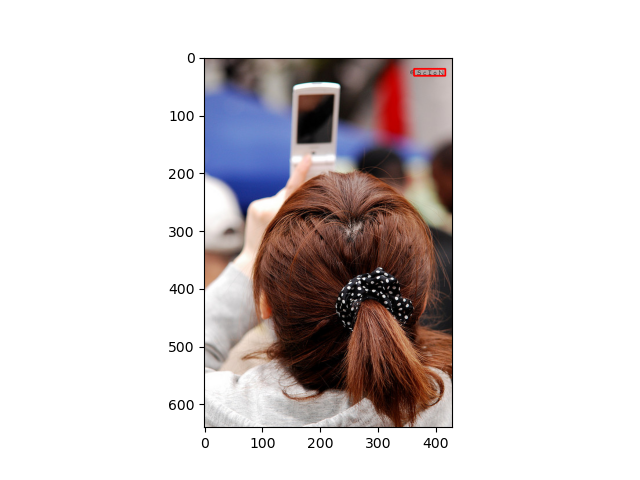

['', 'seadoo']


<IPython.core.display.Javascript object>


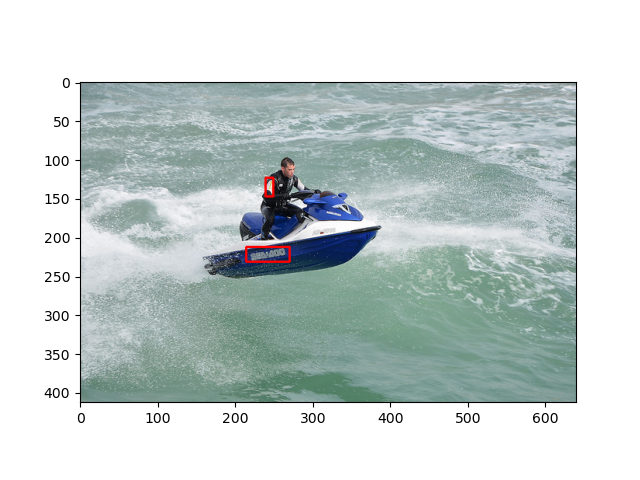

['', '', 'barnes', '', '', 'noble', 'noble', 'barnes']


<IPython.core.display.Javascript object>


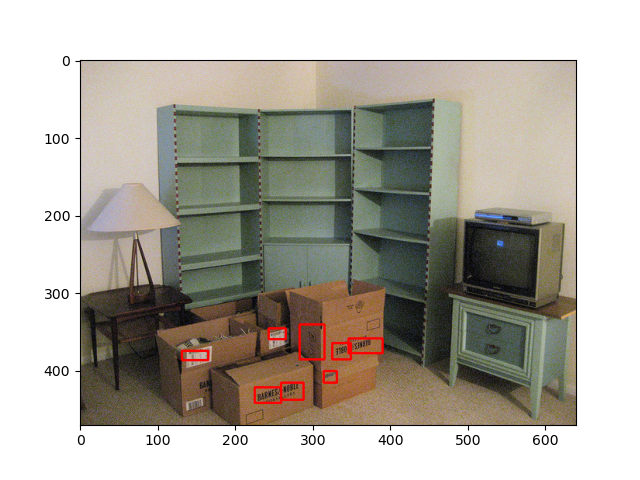

['9', 'bertrand', 'street', 'tbe', 'BERIRAND', 'mitsu', '']


<IPython.core.display.Javascript object>


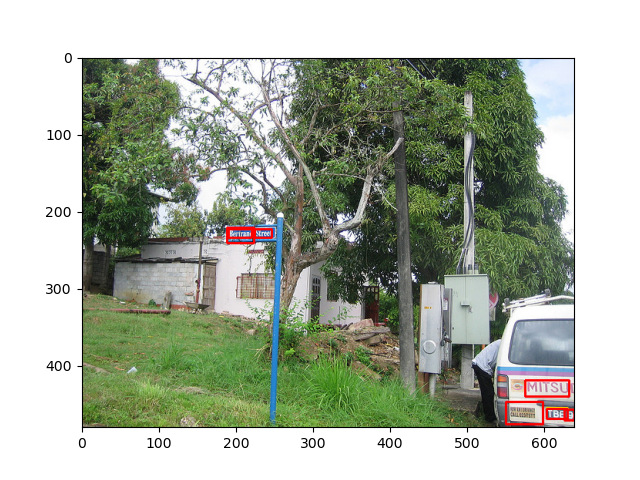

['giants']


<IPython.core.display.Javascript object>


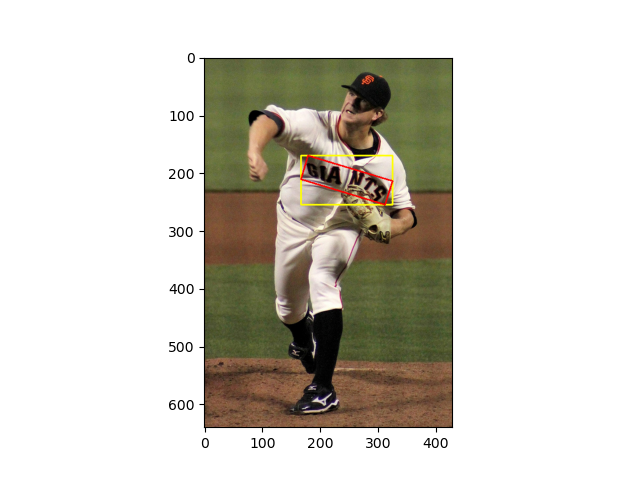

['Dew', 'TakeaSecondtoRelax!', 'to', 'Rest!!', 'and', 'Relax', '', 'Dew', 'diet', 'DEW', 'pepsi', 'Dew', 'Dew', 'Mtn', 'Mtn', 'Moment', 'DEW', 'Down', 'pepsi', 'a', 'Dew', 'Dew', 'pepsi', 'special!', 'Mtn', 'pepsi', '', '3/$12', 'pepsi', 'pepsi', 'Fake', 'diet', 'pepsi', 'diet', 'Mtn', 'Mtn', 'pepsi', 'pepsi', 'diet', 'Mtn', 'Sit']


<IPython.core.display.Javascript object>


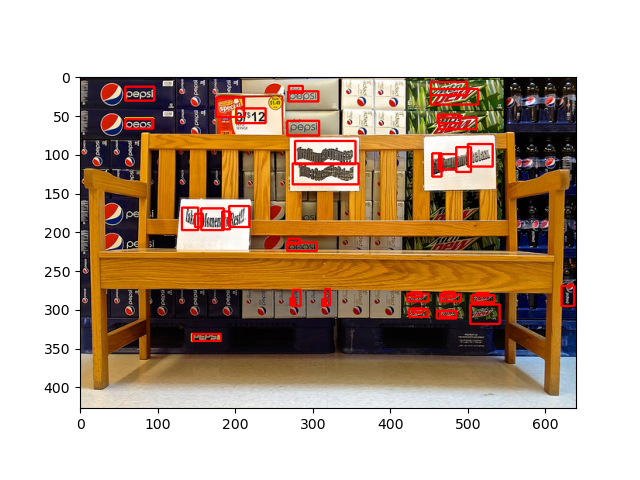

['', '', 'meters', 'quare', 'COOKIN']


<IPython.core.display.Javascript object>


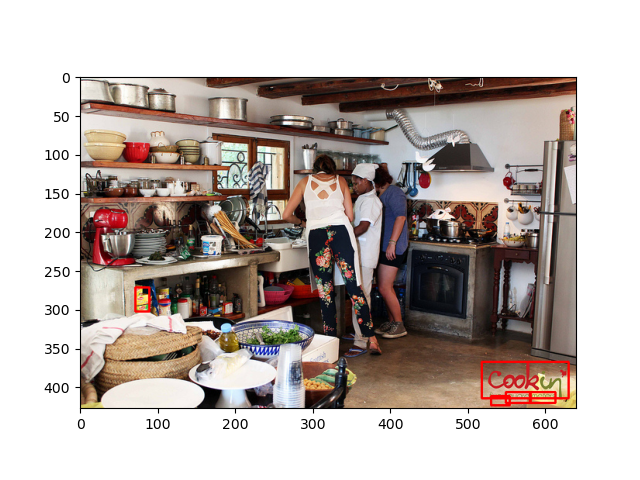

['TAST', '', '', '']


<IPython.core.display.Javascript object>


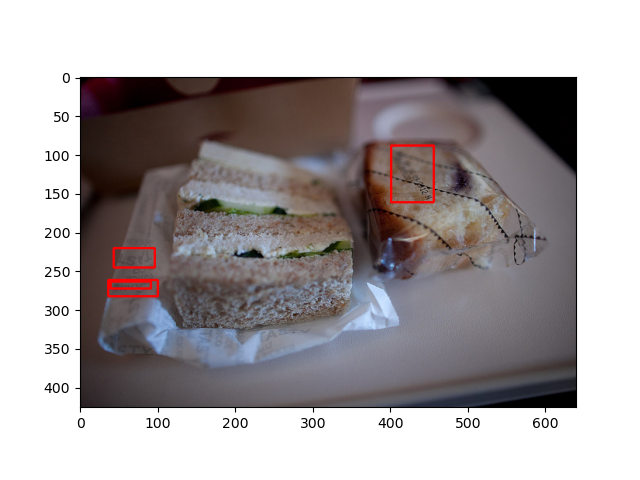

['', 'FIGHTERS', '', '2', 'GOTO']


<IPython.core.display.Javascript object>


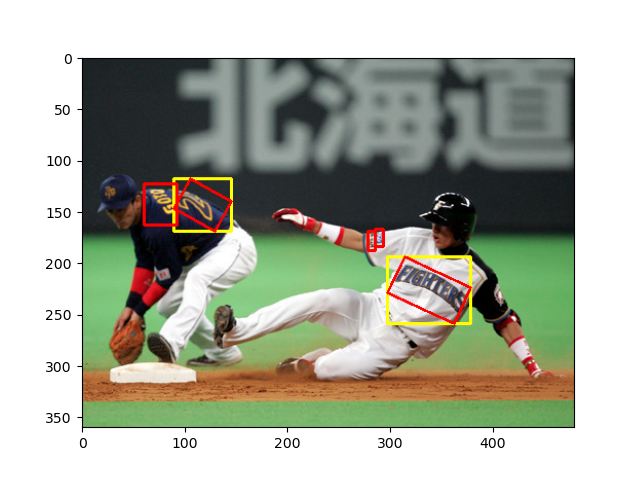

['langford.', 'LANGFORD', 'C', 'WESTON']


<IPython.core.display.Javascript object>


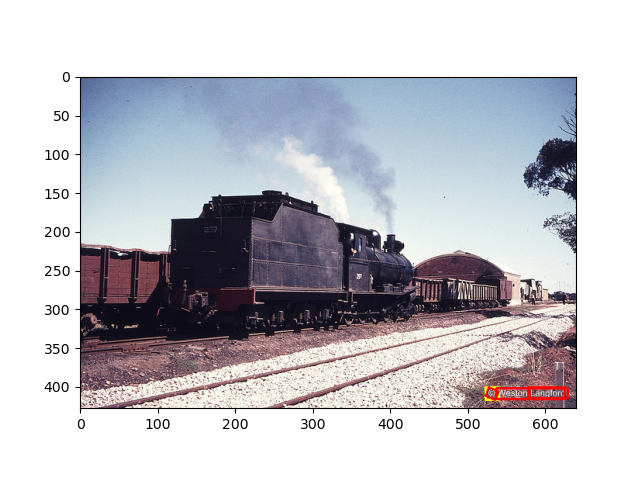

['04/15/2003']


<IPython.core.display.Javascript object>


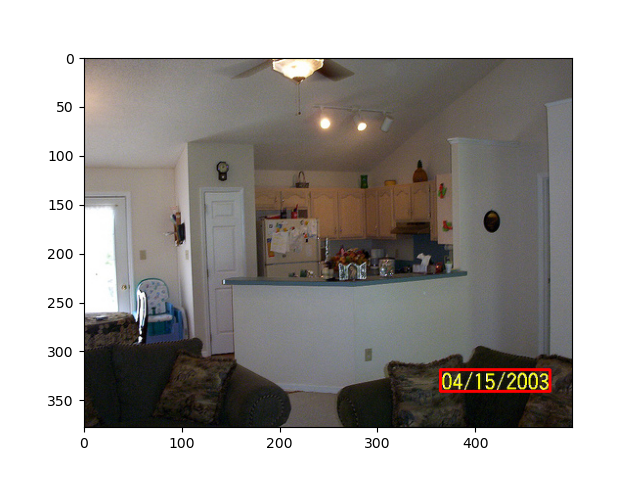

['', '', 'boy', '', '', 'awatress', '', '', '', '', 'orders', '', '', '6', '', 'crets', '', 'for', '', '', '', 'CUT', 'take', '', '', 'not']


<IPython.core.display.Javascript object>


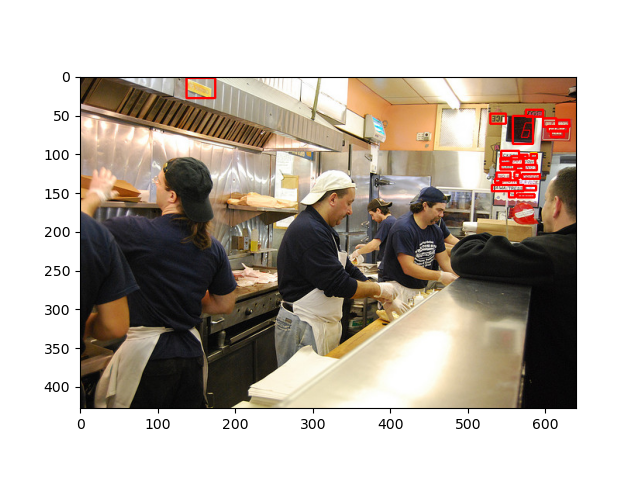

['etch', '5200', '5300', 'RD', 'brigantine']


<IPython.core.display.Javascript object>


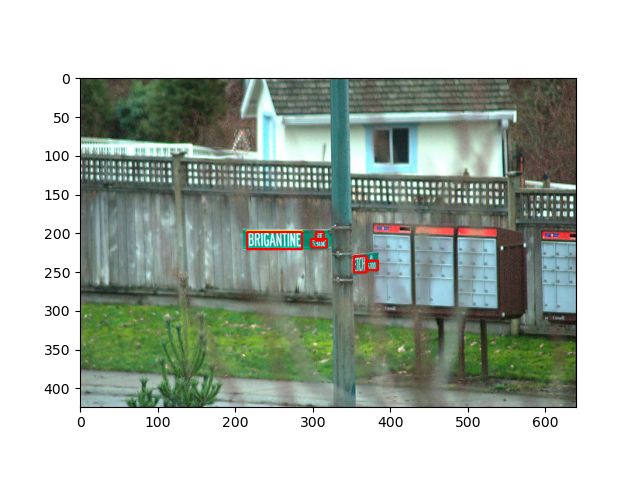

['', 'canada', 'air']


<IPython.core.display.Javascript object>


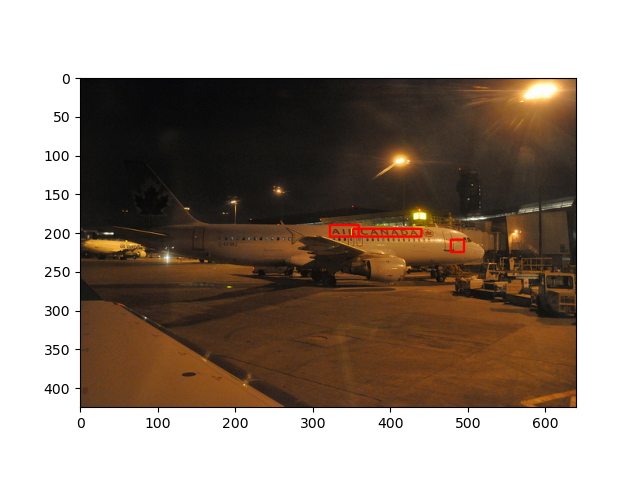

['wisconsin', 'amber']


<IPython.core.display.Javascript object>


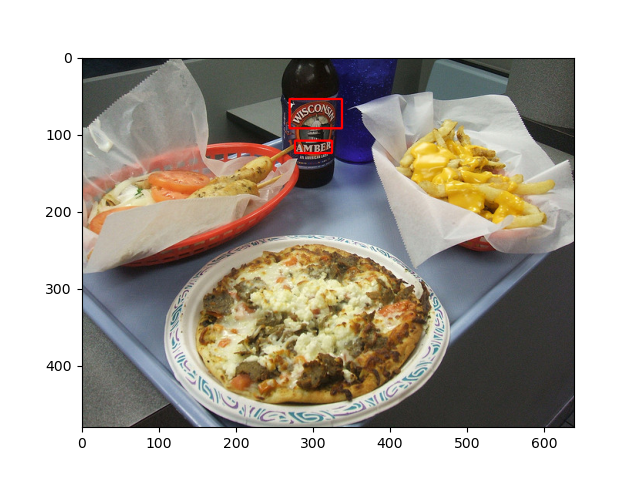

In [4]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    
    img = toVisualizeRectangleRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# SynthText

In [5]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.SynthTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['arrest,', 'but', '"hate"', 'their', 'culture.', 'that', 'things', 'are', 'above', 'the']
tensor([[0.5605, 0.1366, 0.2814, 0.2303],
        [0.2793, 0.2098, 0.0779, 0.1126],
        [0.1008, 0.3688, 0.1003, 0.0998],
        [0.2042, 0.3443, 0.0871, 0.0935],
        [0.3225, 0.3140, 0.1299, 0.1043],
        [0.1677, 0.4520, 0.0757, 0.0822],
        [0.2662, 0.4358, 0.1072, 0.0757],
        [0.3629, 0.4145, 0.0603, 0.0667],
        [0.2969, 0.0647, 0.1028, 0.0821],
        [0.4030, 0.0640, 0.0533, 0.0806]])


<IPython.core.display.Javascript object>


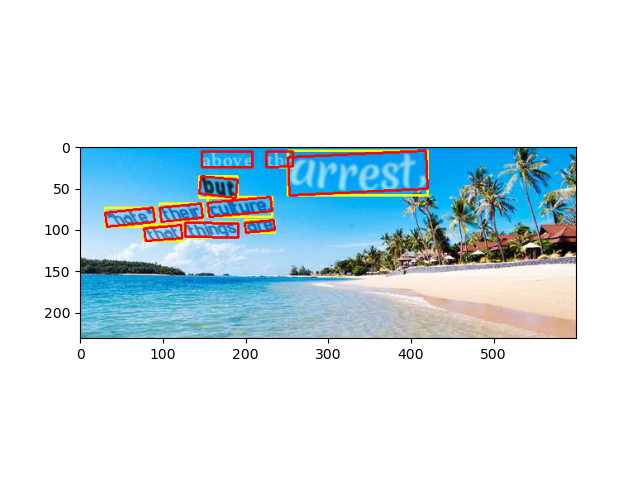

['start', 'the', 'area', 'and', '514', 'From:', 'Re:', 'Why', 'the']
tensor([[0.8285, 0.3927, 0.3175, 0.1086],
        [0.7329, 0.4751, 0.2504, 0.1537],
        [0.5937, 0.0560, 0.3078, 0.0838],
        [0.1719, 0.6006, 0.1591, 0.0523],
        [0.8997, 0.3007, 0.0760, 0.0309],
        [0.6088, 0.3521, 0.1442, 0.0656],
        [0.5005, 0.3954, 0.0840, 0.0616],
        [0.6130, 0.4258, 0.1587, 0.1232],
        [0.6800, 0.1836, 0.3422, 0.1257]])


<IPython.core.display.Javascript object>


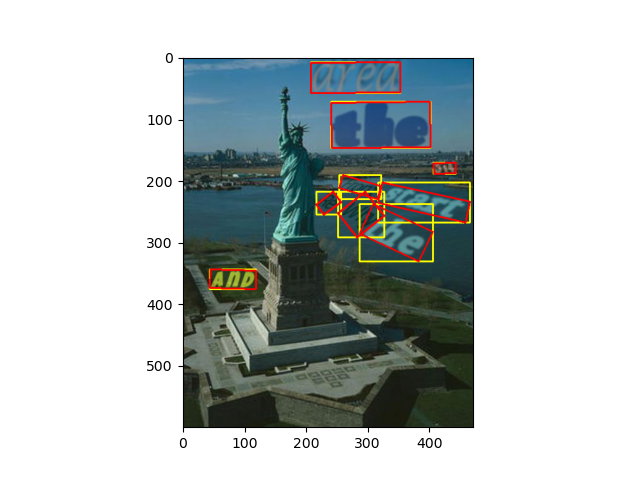

['From:', '-', 'starting', 'This']
tensor([[0.2506, 0.5156, 0.3002, 0.1010],
        [0.5432, 0.3923, 0.0302, 0.0441],
        [0.6852, 0.3986, 0.2214, 0.0534],
        [0.7168, 0.7818, 0.1085, 0.0834]])


<IPython.core.display.Javascript object>


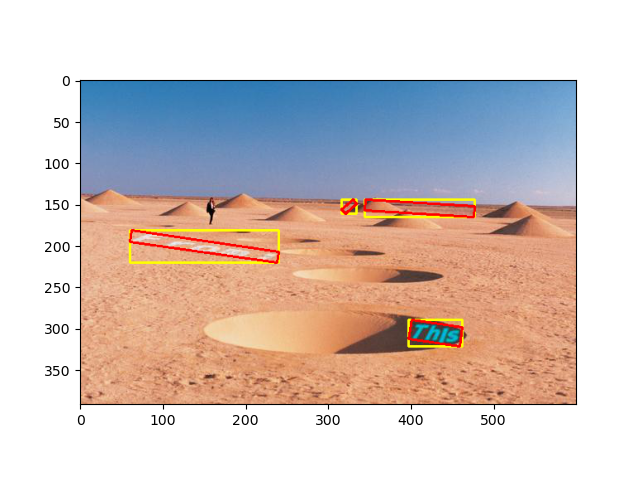

['Message-ID:', 'References:', 'Sender:', 'usenet@news.cso.uiuc.edu', '(Net', 'Organization:', 'University', 'of', 'Illinois', 'Lines:', '6', 'Also', 'remember', 'that', 'most', 'division', 'onto', 'the', 'to', 'have']
tensor([[0.1433, 0.0896, 0.1617, 0.0413],
        [0.1428, 0.1296, 0.1598, 0.0340],
        [0.1145, 0.1732, 0.1026, 0.0339],
        [0.3504, 0.1745, 0.3427, 0.0382],
        [0.5695, 0.1734, 0.0555, 0.0486],
        [0.1567, 0.2203, 0.1864, 0.0411],
        [0.3380, 0.2176, 0.1513, 0.0486],
        [0.4444, 0.2168, 0.0302, 0.0338],
        [0.5317, 0.2169, 0.1107, 0.0338],
        [0.1067, 0.2606, 0.0841, 0.0379],
        [0.1696, 0.2602, 0.0170, 0.0341],
        [0.0945, 0.3035, 0.0639, 0.0337],
        [0.2058, 0.3035, 0.1224, 0.0337],
        [0.3122, 0.3036, 0.0570, 0.0337],
        [0.3867, 0.3048, 0.0620, 0.0313],
        [0.1241, 0.3468, 0.1190, 0.0337],
        [0.2295, 0.3480, 0.0587, 0.0313],
        [0.2981, 0.3468, 0.0419, 0.0337],
        [0.3123, 0.9111, 

<IPython.core.display.Javascript object>


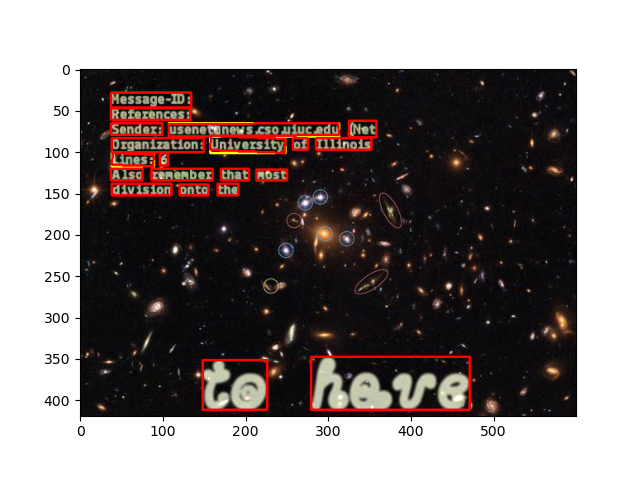

['All', 'East', 'but', 'Xref:', '(Henry', 'Spencer)', 'From:', 'all', 'the']
tensor([[0.6651, 0.6734, 0.0844, 0.0969],
        [0.1949, 0.7984, 0.1482, 0.0895],
        [0.2808, 0.0969, 0.0741, 0.0290],
        [0.2558, 0.1386, 0.1104, 0.0307],
        [0.1087, 0.1880, 0.1477, 0.0486],
        [0.2943, 0.1902, 0.1722, 0.0466],
        [0.1697, 0.8798, 0.2359, 0.2180],
        [0.6265, 0.3956, 0.0429, 0.0540],
        [0.6171, 0.4593, 0.0507, 0.0578]])


<IPython.core.display.Javascript object>


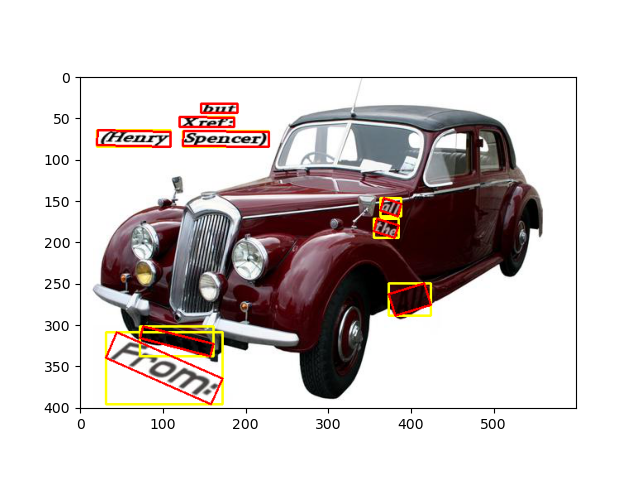

['under', 'the', 'I', 'just', 'the', 'above', '(meaning:']
tensor([[0.6692, 0.8284, 0.5672, 0.2562],
        [0.3470, 0.1238, 0.1837, 0.1167],
        [0.2674, 0.2765, 0.0135, 0.0939],
        [0.4339, 0.3007, 0.2261, 0.1405],
        [0.3399, 0.4385, 0.1816, 0.1100],
        [0.6446, 0.4569, 0.2820, 0.1088],
        [0.4563, 0.6078, 0.4202, 0.1519]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


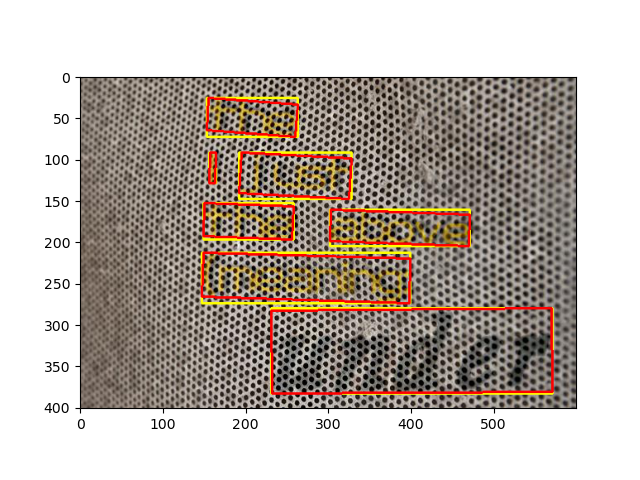

['I', 'have']
tensor([[0.2427, 0.4910, 0.0172, 0.0878],
        [0.2787, 0.3965, 0.1045, 0.1971]])


<IPython.core.display.Javascript object>


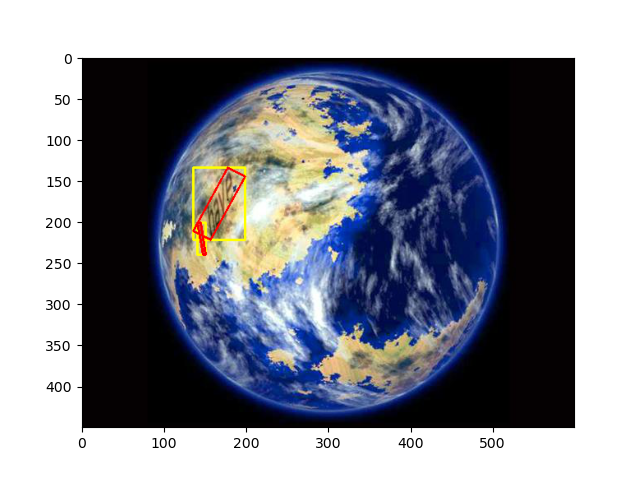

['From:', 'Lab', 'right:', 'and', 'much', 'his', '8-9', 'one', 'classic']
tensor([[0.4395, 0.2792, 0.2339, 0.1074],
        [0.2224, 0.7276, 0.3256, 0.4889],
        [0.6274, 0.6023, 0.2132, 0.0674],
        [0.6688, 0.6829, 0.1695, 0.0866],
        [0.7732, 0.7705, 0.2138, 0.1393],
        [0.8519, 0.8936, 0.1622, 0.1660],
        [0.1862, 0.1331, 0.2950, 0.2361],
        [0.4510, 0.1212, 0.1881, 0.1128],
        [0.7977, 0.1022, 0.3621, 0.1509]])


<IPython.core.display.Javascript object>


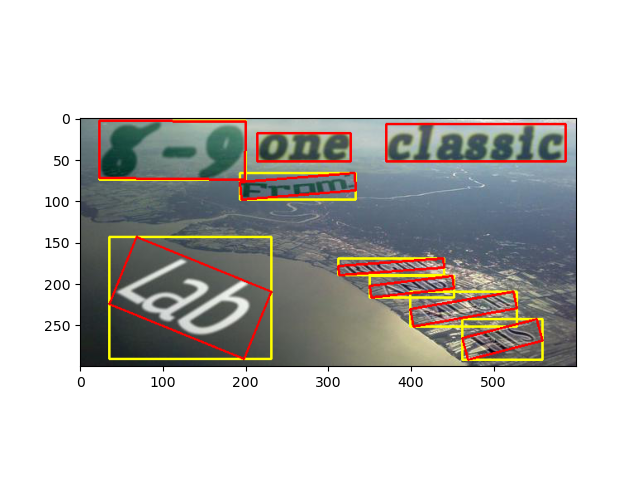

['are.', 'Your', 'James', 'was', 'know', 'been', 'They', 'business,']
tensor([[0.4547, 0.0835, 0.1180, 0.0652],
        [0.6309, 0.0763, 0.1693, 0.0936],
        [0.5910, 0.2029, 0.2198, 0.0895],
        [0.8252, 0.3956, 0.1466, 0.1019],
        [0.9390, 0.8331, 0.0645, 0.2745],
        [0.3490, 0.9096, 0.2191, 0.1245],
        [0.7902, 0.4848, 0.1267, 0.0637],
        [0.1583, 0.9508, 0.2415, 0.1026]])


<IPython.core.display.Javascript object>


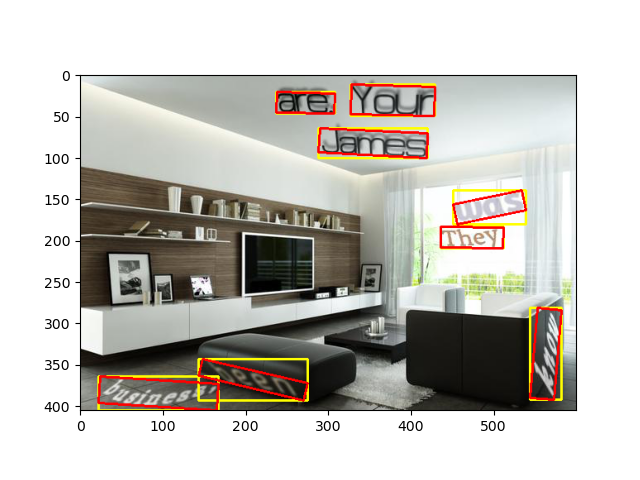

['kind', 'it?', "FBI's", 'and']
tensor([[0.7003, 0.1064, 0.0670, 0.0696],
        [0.6878, 0.1863, 0.0438, 0.0625],
        [0.7000, 0.2578, 0.0699, 0.0644],
        [0.6895, 0.3295, 0.0505, 0.0584]])


<IPython.core.display.Javascript object>


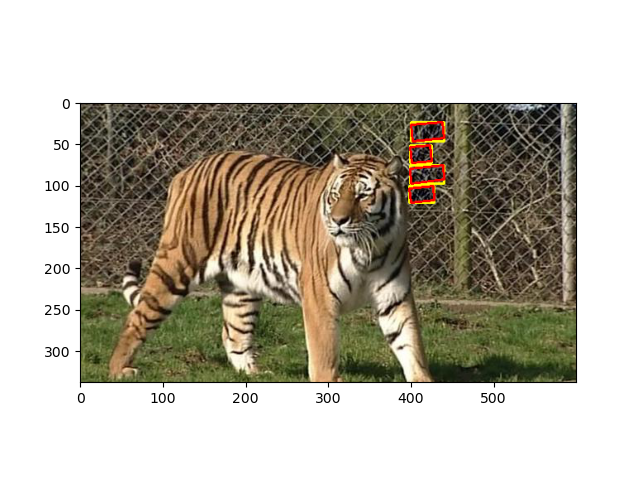

['Lines:', 'European', 'been', 'the', 'the', '19;', 'To:']
tensor([[0.6488, 0.5244, 0.1191, 0.1514],
        [0.3793, 0.3807, 0.2093, 0.1581],
        [0.2827, 0.4391, 0.0984, 0.1128],
        [0.3827, 0.4857, 0.0989, 0.1256],
        [0.5758, 0.0604, 0.0953, 0.0960],
        [0.9266, 0.2500, 0.0314, 0.0568],
        [0.9233, 0.3254, 0.0449, 0.0555]])


<IPython.core.display.Javascript object>


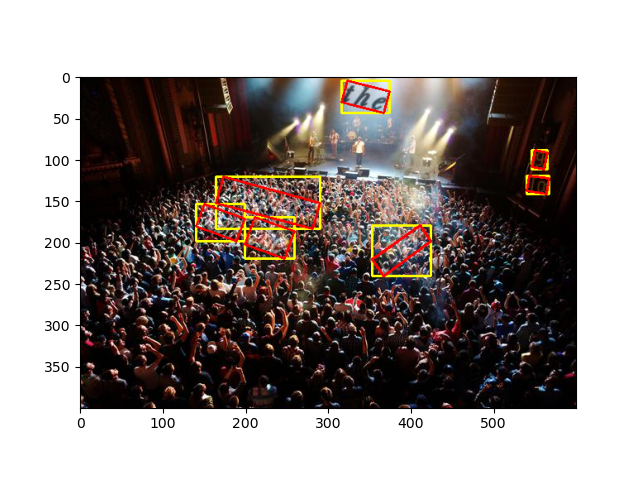

['for', 'Message-ID:', 'Are', 'you', 'reassessing?', '(Laughter.)', 'Frank', 'car', 'is', 'now', 'ok', '(this', 'group']
tensor([[0.4703, 0.3412, 0.0808, 0.0430],
        [0.8556, 0.8548, 0.1776, 0.0361],
        [0.4832, 0.0433, 0.0601, 0.0699],
        [0.5305, 0.0453, 0.0484, 0.0545],
        [0.5944, 0.0354, 0.0949, 0.0392],
        [0.6714, 0.0288, 0.0729, 0.0819],
        [0.7616, 0.9342, 0.3034, 0.1159],
        [0.4350, 0.0899, 0.0651, 0.0295],
        [0.4853, 0.0817, 0.0361, 0.0413],
        [0.5310, 0.0775, 0.0521, 0.0280],
        [0.5758, 0.0697, 0.0354, 0.0408],
        [0.6129, 0.0597, 0.0509, 0.0560],
        [0.6614, 0.0605, 0.0498, 0.0282]])


<IPython.core.display.Javascript object>


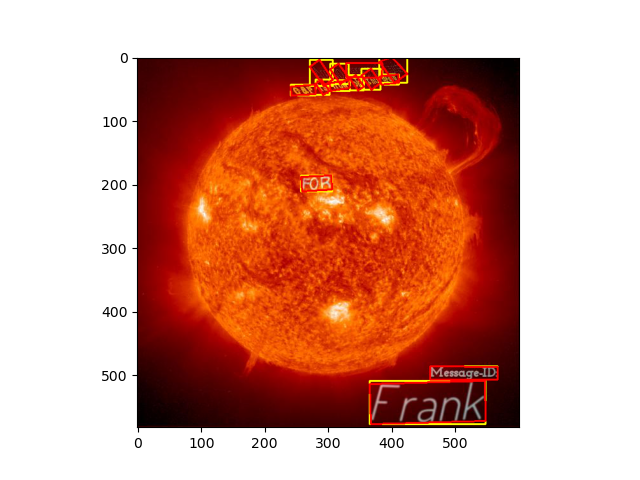

['Date:', 'many', 'some', 'get', 'BBS', 'bps', 'Jim', 'calls,']
tensor([[0.8879, 0.3821, 0.2262, 0.1305],
        [0.6913, 0.7585, 0.3238, 0.1042],
        [0.7072, 0.9079, 0.3834, 0.1016],
        [0.8873, 0.5230, 0.2511, 0.2013],
        [0.0397, 0.8020, 0.0840, 0.0722],
        [0.0361, 0.8870, 0.0678, 0.0675],
        [0.5224, 0.8106, 0.2189, 0.1027],
        [0.7153, 0.5671, 0.0810, 0.0616]])


<IPython.core.display.Javascript object>


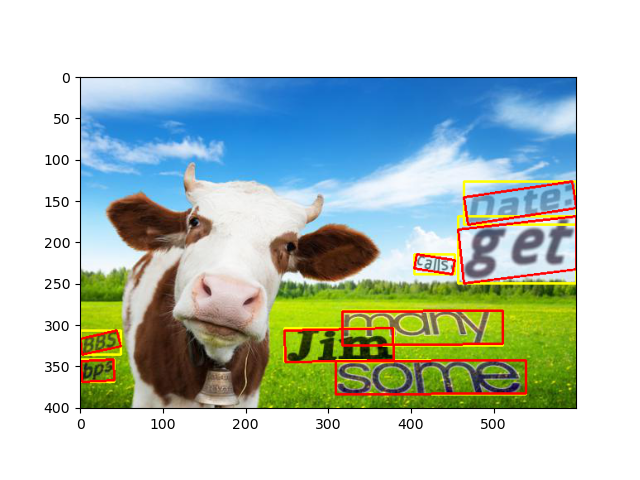

['how', '>be', 'from', 'Wayne', 'Ohio', 'one', 'Message-ID:', 'Sender:', 'has', 'you']
tensor([[0.1912, 0.4227, 0.0731, 0.0861],
        [0.4063, 0.0696, 0.1210, 0.1100],
        [0.6177, 0.0863, 0.2299, 0.1391],
        [0.2881, 0.2957, 0.1413, 0.2387],
        [0.5986, 0.4504, 0.0874, 0.0986],
        [0.2230, 0.4777, 0.0976, 0.0944],
        [0.5985, 0.1961, 0.2696, 0.0771],
        [0.6209, 0.2781, 0.1651, 0.0638],
        [0.0932, 0.9029, 0.0649, 0.0456],
        [0.3292, 0.8723, 0.0902, 0.0744]])


<IPython.core.display.Javascript object>


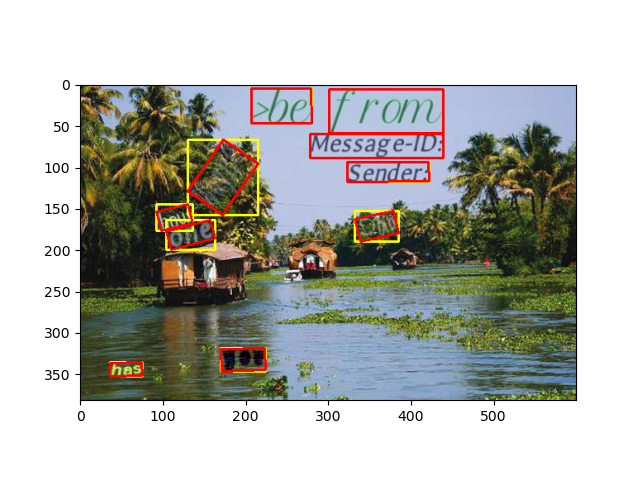

['Now,', 'heart', 'Organization:', 'Lines:', '11', 'team', '?', 'last', 'the', 'NHTSA', 'Organization:', '22.']
tensor([[0.0500, 0.0563, 0.0997, 0.1290],
        [0.2939, 0.1270, 0.3076, 0.1987],
        [0.8554, 0.7405, 0.2282, 0.1228],
        [0.8523, 0.8265, 0.0962, 0.0690],
        [0.9371, 0.8348, 0.0209, 0.0597],
        [0.8152, 0.9290, 0.0877, 0.0618],
        [0.8936, 0.9282, 0.0154, 0.0607],
        [0.9556, 0.9289, 0.0567, 0.0636],
        [0.0238, 0.0297, 0.0515, 0.0789],
        [0.2870, 0.8134, 0.3920, 0.3164],
        [0.3462, 0.5876, 0.3261, 0.2633],
        [0.8593, 0.2931, 0.1198, 0.1836]])


<IPython.core.display.Javascript object>


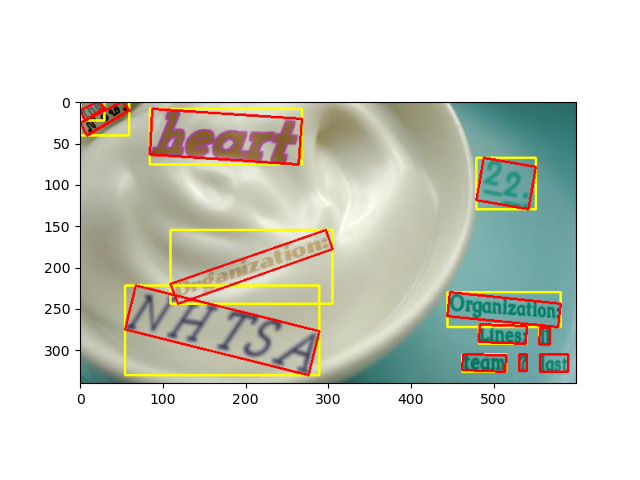

In [6]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectangleRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# ICDAR2015

In [7]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDAR2015TextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['Travel', '###', 'your', 'purchases', 'for', 'Top', '###', 'Neck', 'Pillow.', '###', '###', '###', '###']
tensor([[0.4160, 0.3653, 0.0461, 0.1083],
        [0.3945, 0.2826, 0.0219, 0.0625],
        [0.4266, 0.3264, 0.0406, 0.0889],
        [0.5102, 0.4410, 0.1250, 0.2208],
        [0.3680, 0.2965, 0.0219, 0.0681],
        [0.3688, 0.2417, 0.0266, 0.0889],
        [0.3848, 0.3236, 0.0117, 0.0500],
        [0.4691, 0.4472, 0.0523, 0.1250],
        [0.5418, 0.5569, 0.0836, 0.1778],
        [0.4832, 0.5326, 0.0852, 0.1319],
        [0.3281, 0.2125, 0.0156, 0.0444],
        [0.3383, 0.2271, 0.0078, 0.0319],
        [0.1871, 0.0312, 0.0383, 0.0625]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


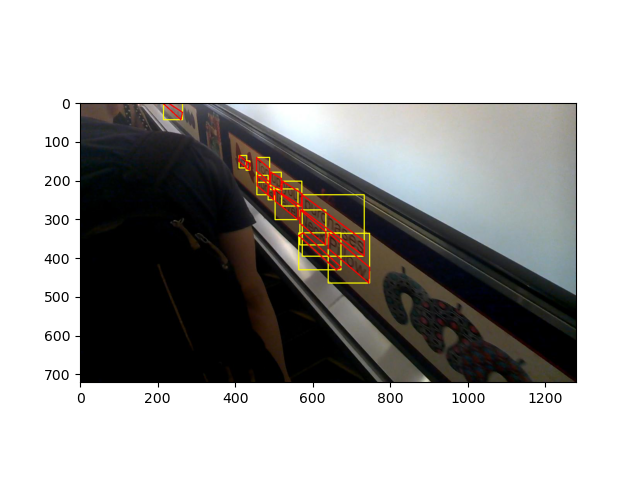

['###']
tensor([[0.2238, 0.3118, 0.0633, 0.0681]])


<IPython.core.display.Javascript object>


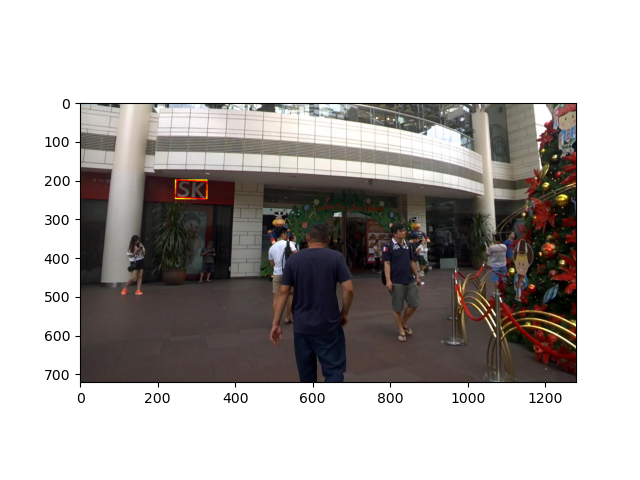

['ONSEN', '01-06', '###', '###', '###', '###', '###', 'OSEN', '###']
tensor([[0.4906, 0.3451, 0.2000, 0.1569],
        [0.5852, 0.1861, 0.0297, 0.0306],
        [0.6973, 0.2424, 0.0289, 0.0347],
        [0.7266, 0.2312, 0.0312, 0.0319],
        [0.7633, 0.2188, 0.0547, 0.0458],
        [0.7168, 0.2569, 0.0430, 0.0417],
        [0.7625, 0.2417, 0.0531, 0.0389],
        [0.5004, 0.4653, 0.0492, 0.0278],
        [0.8133, 0.1139, 0.0172, 0.0167]])


<IPython.core.display.Javascript object>


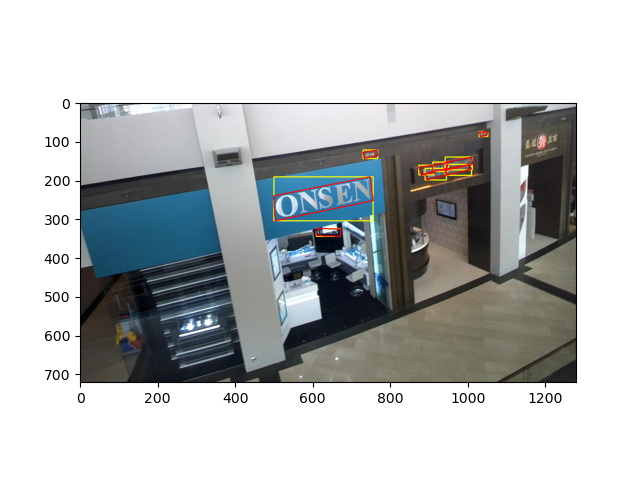

["there's", 'always', 'time', '###', 'chill', 'NEW', 'SEASONS']
tensor([[0.7359, 0.2410, 0.0359, 0.0792],
        [0.7316, 0.2993, 0.0430, 0.0903],
        [0.7738, 0.2597, 0.0445, 0.0944],
        [0.7270, 0.3521, 0.0117, 0.0486],
        [0.7559, 0.3528, 0.0492, 0.1083],
        [0.7480, 0.4646, 0.0211, 0.0486],
        [0.7160, 0.1667, 0.0320, 0.0417]])


<IPython.core.display.Javascript object>


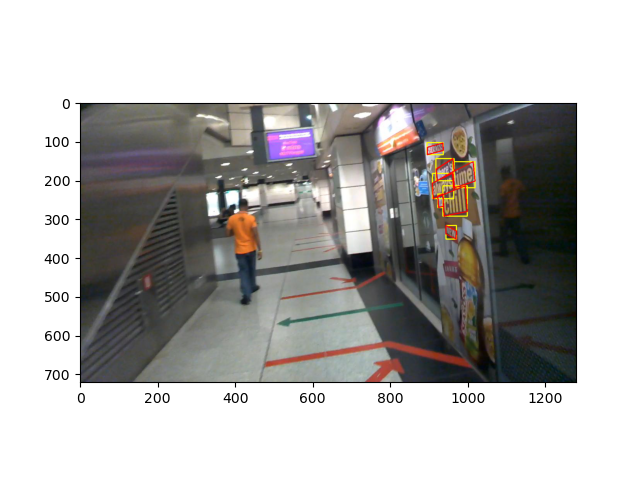

['FFICINE', 'PANERAI', '###', '###', '###']
tensor([[0.3117, 0.3368, 0.0672, 0.0264],
        [0.3828, 0.3340, 0.0734, 0.0208],
        [0.0539, 0.1181, 0.0531, 0.0306],
        [0.1613, 0.1986, 0.0164, 0.0333],
        [0.5211, 0.3931, 0.0312, 0.0306]])


<IPython.core.display.Javascript object>


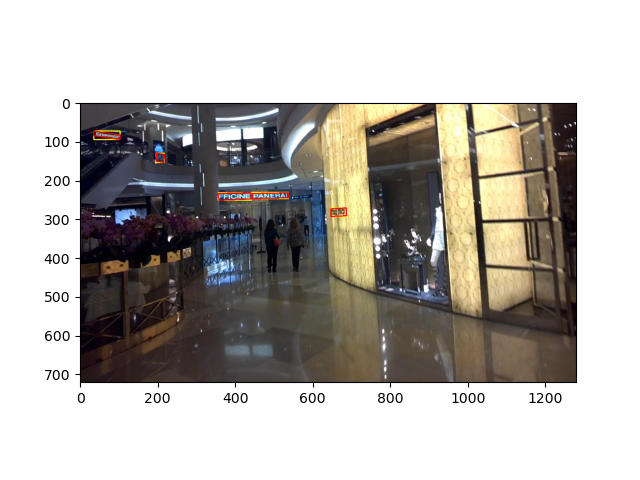

['Pain', 'Back', 'Foot', 'Knee', '###', 'Your', 'Stop', 'Our', 'Solution', '###', '###', '###']
tensor([[0.3262, 0.7840, 0.0508, 0.0681],
        [0.2738, 0.7687, 0.0555, 0.0681],
        [0.1527, 0.7333, 0.0398, 0.0639],
        [0.2027, 0.7486, 0.0523, 0.0694],
        [0.2363, 0.7569, 0.0195, 0.0583],
        [0.1145, 0.7215, 0.0414, 0.0653],
        [0.0742, 0.7118, 0.0359, 0.0653],
        [0.1535, 0.8375, 0.0305, 0.0472],
        [0.2031, 0.8556, 0.0734, 0.0639],
        [0.7312, 0.4215, 0.0562, 0.0264],
        [0.7297, 0.4417, 0.0453, 0.0222],
        [0.4238, 0.8125, 0.0242, 0.0806]])


<IPython.core.display.Javascript object>


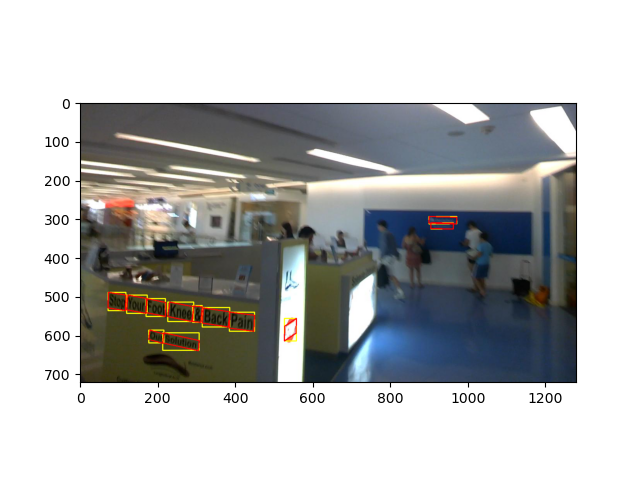

['RALPH', 'LAUREN', '###', 'LAUREN', 'adidas', 'CANS', 'PLASTIC']
tensor([[0.3473, 0.1375, 0.0539, 0.0333],
        [0.4105, 0.1326, 0.0586, 0.0264],
        [0.6113, 0.1139, 0.0320, 0.0194],
        [0.6480, 0.1097, 0.0352, 0.0250],
        [0.8516, 0.0590, 0.0672, 0.0625],
        [0.9293, 0.4153, 0.0117, 0.0639],
        [0.9633, 0.4340, 0.0125, 0.0903]])


<IPython.core.display.Javascript object>


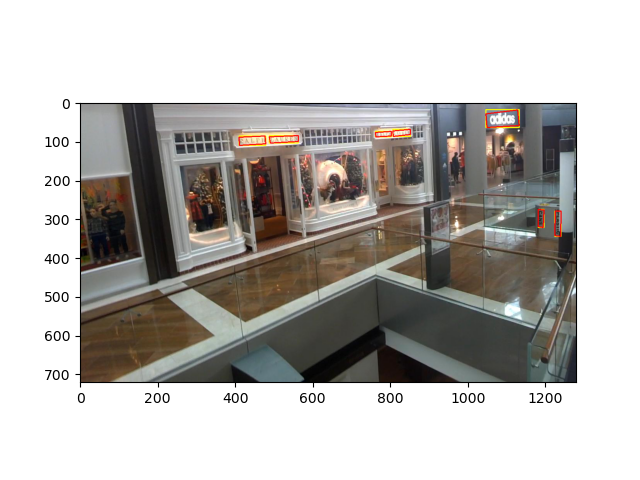

['###', 'KEMIUCHI', '###', '###', '###', '###', '###']
tensor([[0.7992, 0.4861, 0.0188, 0.0306],
        [0.2090, 0.3562, 0.1336, 0.0736],
        [0.2727, 0.4500, 0.0219, 0.0306],
        [0.2914, 0.4479, 0.0219, 0.0181],
        [0.3066, 0.4507, 0.0133, 0.0153],
        [0.2840, 0.4764, 0.0508, 0.0306],
        [0.9121, 0.6250, 0.0398, 0.0278]])


<IPython.core.display.Javascript object>


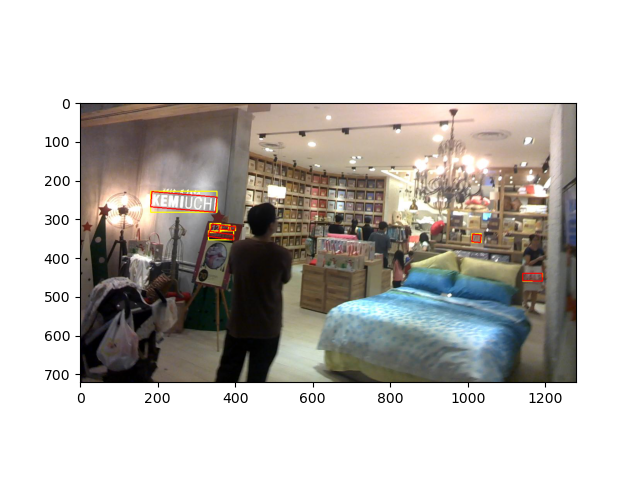

['EXIT', '###', '###', '###', '###']
tensor([[0.2934, 0.3118, 0.0273, 0.0292],
        [0.5418, 0.2847, 0.1195, 0.0556],
        [0.5941, 0.3111, 0.0992, 0.0389],
        [0.7902, 0.2681, 0.0258, 0.0361],
        [0.0945, 0.2514, 0.0609, 0.0556]])


<IPython.core.display.Javascript object>

['###', 'SALE', 'promod', 'NOW!', '###', '###', '-70%', '###', '###', '###', '###']
tensor([[0.0684, 0.1160, 0.1289, 0.1764],
        [0.0777, 0.5667, 0.0680, 0.0417],
        [0.0734, 0.4972, 0.1469, 0.0500],
        [0.0734, 0.6167, 0.0844, 0.0472],
        [0.0547, 0.6764, 0.0328, 0.0389],
        [0.0875, 0.6764, 0.0250, 0.0278],
        [0.0656, 0.7201, 0.0578, 0.0403],
        [0.2535, 0.5264, 0.0398, 0.0750],
        [0.8059, 0.1653, 0.1789, 0.3222],
        [0.4563, 0.4549, 0.0500, 0.0181],
        [0.4594, 0.4701, 0.0656, 0.0208]])


<IPython.core.display.Javascript object>


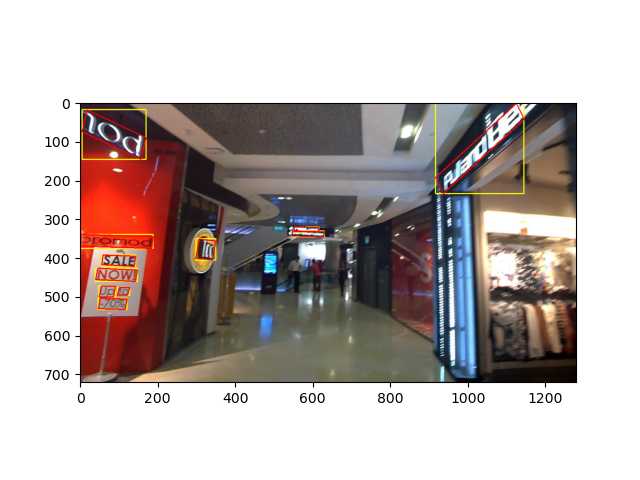

['###', '###', 'SALE', 'FASHION', 'OUTLET', '###', 'STORE', 'PERCENT', '###', '###', 'OFF', '###', '###', 'OFF', '###', '###', 'TEKS', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.4027, 0.3167, 0.0195, 0.0139],
        [0.4348, 0.4069, 0.0461, 0.0139],
        [0.4270, 0.2632, 0.0852, 0.0486],
        [0.5352, 0.1424, 0.0875, 0.0347],
        [0.5133, 0.1687, 0.0469, 0.0208],
        [0.2816, 0.2951, 0.0258, 0.0542],
        [0.5547, 0.1660, 0.0391, 0.0208],
        [0.5250, 0.3493, 0.0391, 0.0181],
        [0.2082, 0.2076, 0.0211, 0.0153],
        [0.5348, 0.2951, 0.0617, 0.0903],
        [0.5535, 0.3472, 0.0180, 0.0194],
        [0.4121, 0.3639, 0.0445, 0.0750],
        [0.4465, 0.3472, 0.0227, 0.0500],
        [0.4465, 0.3889, 0.0273, 0.0250],
        [0.7992, 0.0792, 0.0687, 0.0472],
        [0.9328, 0.2632, 0.0391,

<IPython.core.display.Javascript object>


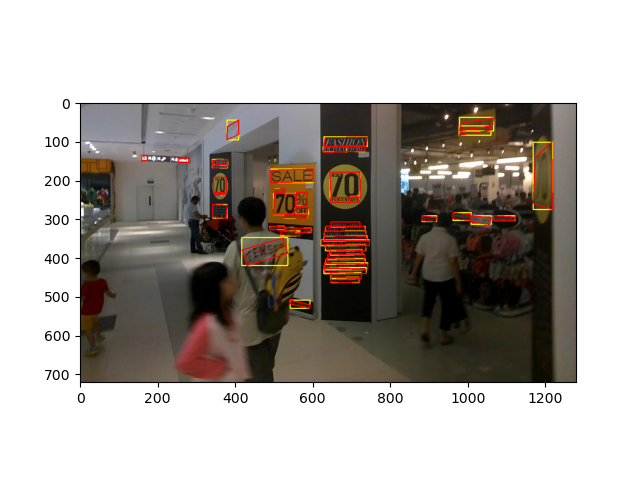

['###', '###', '###', '###', 'REBATE', '###', 'Bank', 'OCBC', '###', '###', 'JOSE', 'EBER', '###', 'YEAR', '###', '###', 'STORES', '###', '###', '###', '###', '###']
tensor([[0.9242, 0.2549, 0.0172, 0.0486],
        [0.9797, 0.1889, 0.0375, 0.0722],
        [0.5309, 0.2403, 0.0117, 0.0306],
        [0.5422, 0.2382, 0.0203, 0.0292],
        [0.5867, 0.2403, 0.0625, 0.0361],
        [0.5328, 0.2646, 0.0141, 0.0264],
        [0.7535, 0.0417, 0.0742, 0.0528],
        [0.6660, 0.0396, 0.0992, 0.0542],
        [0.5367, 0.3056, 0.0188, 0.0250],
        [0.5719, 0.2840, 0.0953, 0.0264],
        [0.8945, 0.3153, 0.0391, 0.0306],
        [0.9375, 0.3146, 0.0438, 0.0319],
        [0.8340, 0.2639, 0.0273, 0.0722],
        [0.5613, 0.3042, 0.0305, 0.0167],
        [0.5984, 0.3021, 0.0422, 0.0208],
        [0.5586, 0.2639, 0.0328, 0.0194],
        [0.5980, 0.2639, 0.0430, 0.0194],
        [0.7063, 0.2660, 0.0312, 0.0264],
        [0.7086, 0.1722, 0.0453, 0.0278],
        [0.0207, 0.0847, 0.0414, 0.0

<IPython.core.display.Javascript object>


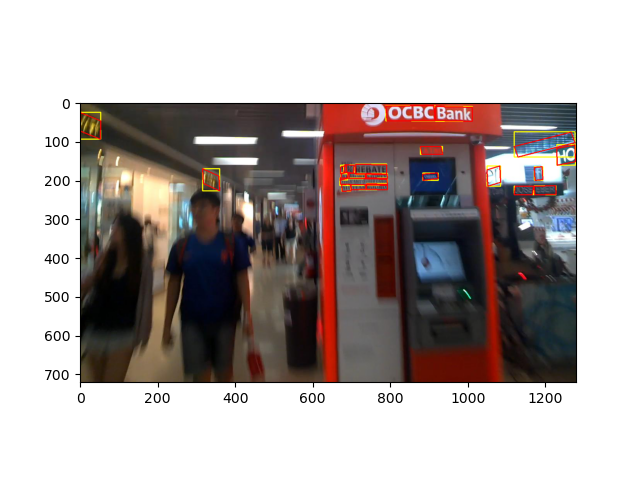

['BAKING', 'SOON', 'BAKING', 'SOON', '###', '###', '###', '###', '###']
tensor([[0.5398, 0.4472, 0.0453, 0.0222],
        [0.5402, 0.4743, 0.0336, 0.0236],
        [0.6164, 0.4500, 0.0516, 0.0194],
        [0.6160, 0.4785, 0.0398, 0.0208],
        [0.5938, 0.3569, 0.0063, 0.0222],
        [0.6156, 0.3535, 0.0375, 0.0292],
        [0.5211, 0.3639, 0.0062, 0.0222],
        [0.5395, 0.3604, 0.0320, 0.0292],
        [0.4156, 0.3701, 0.0328, 0.0236]])


<IPython.core.display.Javascript object>


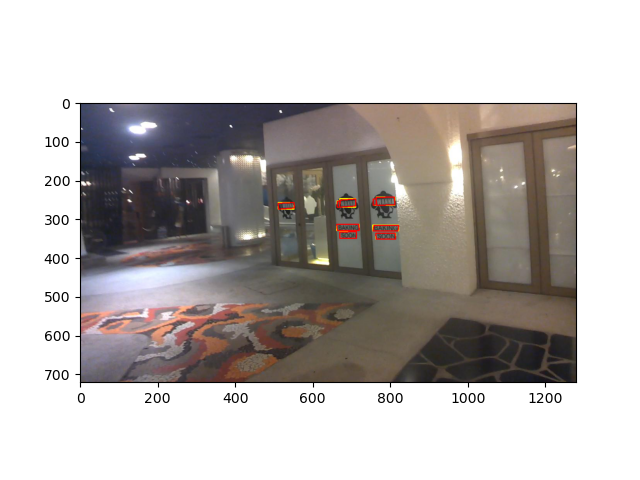

['WIN', '###', 'THE', 'MONTH', 'SUSH', '###', '###', 'WINES', '###', '###', 'WIN', '###', '###', 'WIN', 'WIN', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.4164, 0.1889, 0.0203, 0.0194],
        [0.9113, 0.1264, 0.0180, 0.0250],
        [0.4746, 0.0750, 0.0336, 0.0361],
        [0.5270, 0.0729, 0.0648, 0.0375],
        [0.2355, 0.2410, 0.0398, 0.0208],
        [0.4410, 0.0792, 0.0289, 0.0389],
        [0.4918, 0.3097, 0.0086, 0.0167],
        [0.3926, 0.0847, 0.0586, 0.0417],
        [0.4992, 0.5014, 0.0078, 0.0139],
        [0.9508, 0.1201, 0.0531, 0.0319],
        [0.3742, 0.3840, 0.0203, 0.0181],
        [0.4246, 0.3813, 0.0195, 0.0208],
        [0.4531, 0.3778, 0.0172, 0.0167],
        [0.3820, 0.5819, 0.0187, 0.0194],
        [0.4074, 0.5764, 0.0211, 0.0194],
        [0.4582, 0.5646, 0.0211, 0.0236],
        [0.4461, 0.7597, 0.0187, 0.0167],
        [0.3969, 0.7701, 0.0203, 0.0153],
        [0.3352, 0.2299, 0.0125, 0.0236],
        [0.5047, 0.6889, 0.0125, 0.

<IPython.core.display.Javascript object>


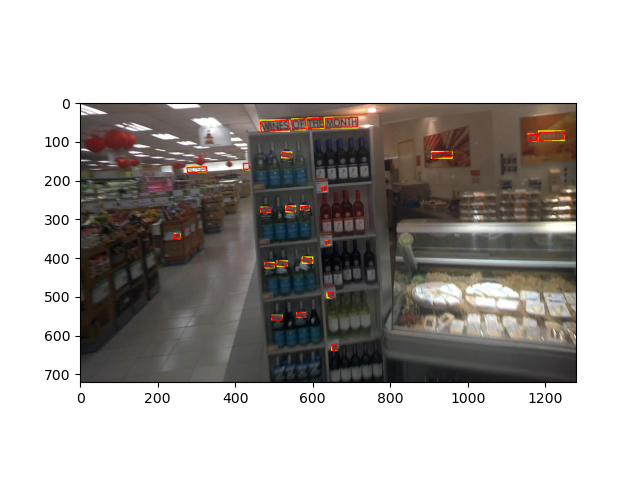

['###', '###', '###', '###', '###', 'BLOUSES', 'ALL', '###', '###', '###', '###', 'ant']
tensor([[0.8758, 0.5653, 0.0172, 0.0472],
        [0.7402, 0.3910, 0.0508, 0.0431],
        [0.9031, 0.5903, 0.0469, 0.1500],
        [0.9371, 0.5854, 0.0258, 0.0736],
        [0.7219, 0.2569, 0.0375, 0.0556],
        [0.9023, 0.4833, 0.1000, 0.1472],
        [0.8754, 0.3479, 0.0508, 0.1097],
        [0.8695, 0.5306, 0.0188, 0.0333],
        [0.7902, 0.1896, 0.0180, 0.0542],
        [0.3000, 0.4306, 0.0359, 0.0556],
        [0.9297, 0.3944, 0.0297, 0.0556],
        [0.9297, 0.2819, 0.0516, 0.1528]])


<IPython.core.display.Javascript object>


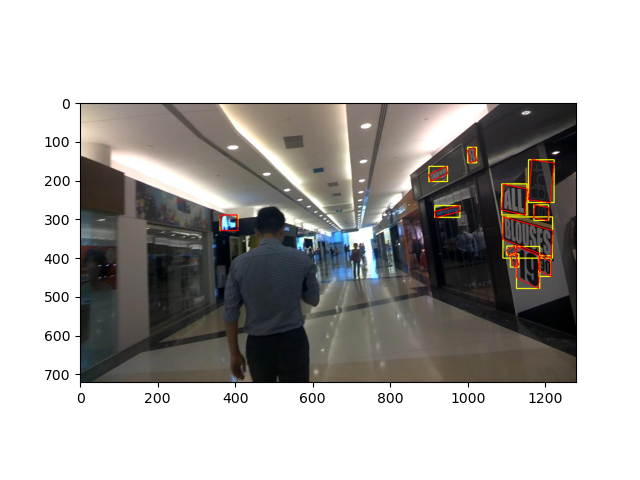

In [8]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectangleRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Focused Scene Text

In [9]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARFocusedSceneTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['Infections', '###', 'Africa', 'Hypertension:', 'who', '###', '###', 'risk?', 'Gut', 'genomics', 'International', 'Cooperation', '###', 'EU-funded', 'Health', 'Research', '###', '###']
tensor([[0.2469, 0.2919, 0.1142, 0.0305],
        [0.3212, 0.2890, 0.0195, 0.0285],
        [0.3710, 0.2867, 0.0651, 0.0309],
        [0.2729, 0.3557, 0.1631, 0.0409],
        [0.3852, 0.3463, 0.0486, 0.0297],
        [0.4248, 0.3449, 0.0157, 0.0285],
        [0.4500, 0.3455, 0.0208, 0.0258],
        [0.4919, 0.3412, 0.0481, 0.0305],
        [0.2130, 0.4145, 0.0417, 0.0282],
        [0.2966, 0.4151, 0.1111, 0.0401],
        [0.6287, 0.5610, 0.2456, 0.0664],
        [0.6235, 0.6318, 0.2351, 0.0698],
        [0.5193, 0.7060, 0.0190, 0.0278],
        [0.5948, 0.6985, 0.1155, 0.0382],
        [0.5466, 0.7473, 0.0720, 0.0332],
        [0.6385, 0.7386, 0.0954, 0.0359],
        [0.7283, 0.9913, 0.0908, 0.0166],
        [0.6564, 0.9959, 0.0504, 0.0073]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


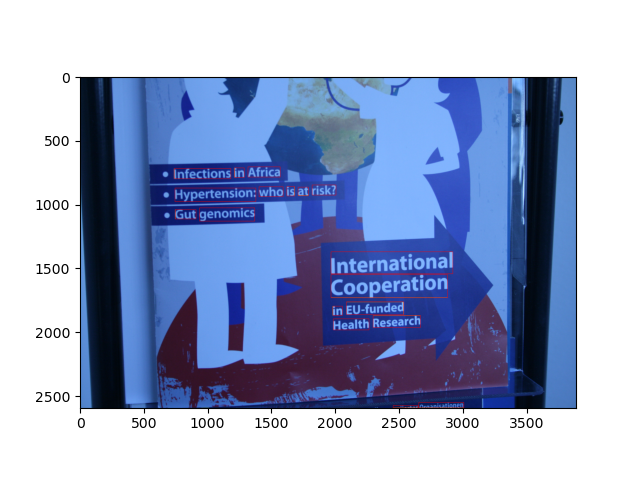

['Boundary', 'Road']
tensor([[0.3641, 0.4615, 0.5156, 0.1312],
        [0.7938, 0.4479, 0.2688, 0.1125]])


<IPython.core.display.Javascript object>


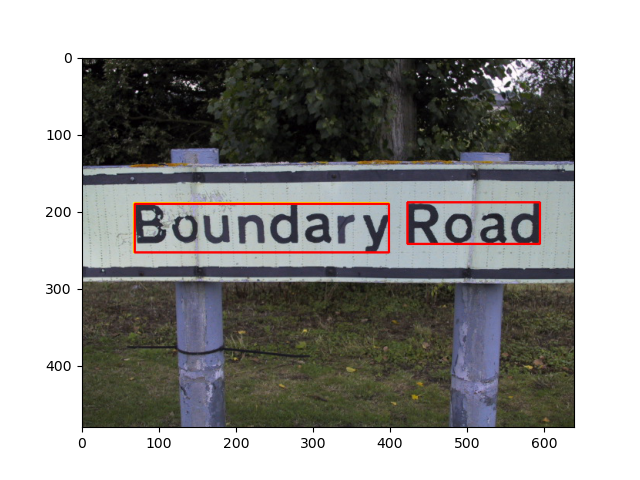

['###', 'Java', 'Language', 'Guide', '###', 'Guy', 'Steele', '###']
tensor([[0.1195, 0.4615, 0.2391, 0.1896],
        [0.6195, 0.4229, 0.5797, 0.2667],
        [0.2758, 0.7229, 0.5453, 0.1792],
        [0.7703, 0.7021, 0.3594, 0.1417],
        [0.0391, 0.9208, 0.0687, 0.1042],
        [0.1555, 0.9312, 0.1266, 0.1042],
        [0.3352, 0.9271, 0.1953, 0.0833],
        [0.9414, 0.3250, 0.0516, 0.0375]])


<IPython.core.display.Javascript object>


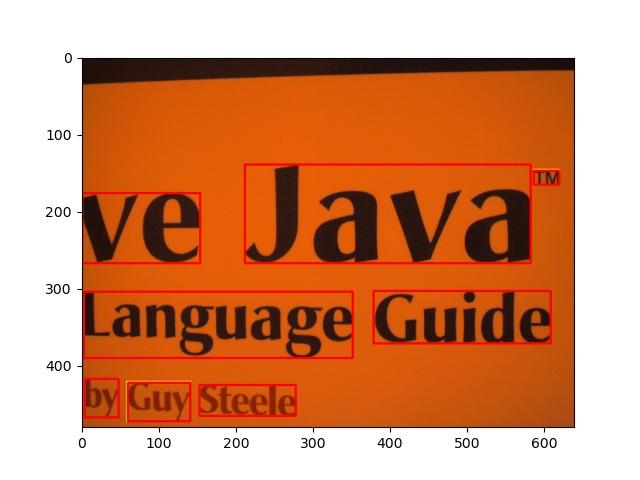

['WHSmith', 'Summer', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.4938, 0.5396, 0.9469, 0.2208],
        [0.2258, 0.9552, 0.1109, 0.0271],
        [0.2945, 0.8135, 0.0109, 0.0271],
        [0.5617, 0.9427, 0.0328, 0.0604],
        [0.7961, 0.9448, 0.0297, 0.0562],
        [0.6391, 0.8687, 0.0125, 0.0292],
        [0.8789, 0.8698, 0.0109, 0.0271],
        [0.6398, 0.8896, 0.0234, 0.0042],
        [0.7195, 0.8917, 0.0234, 0.0042],
        [0.6313, 0.9083, 0.0188, 0.0125],
        [0.7102, 0.9094, 0.0172, 0.0104],
        [0.7914, 0.9073, 0.0672, 0.0104],
        [0.3258, 0.8417, 0.0516, 0.0083],
        [0.3305, 0.8531, 0.0391, 0.0021],
        [0.3313, 0.8802, 0.0719, 0.0104],
        [0.3266, 0.9125, 0.0687, 0.0000],
        [0.3297, 0.9177, 0.0687, 0.0021],
        [0.3281, 0.9240, 0.0750, 0.0021],
        [0.2

<IPython.core.display.Javascript object>


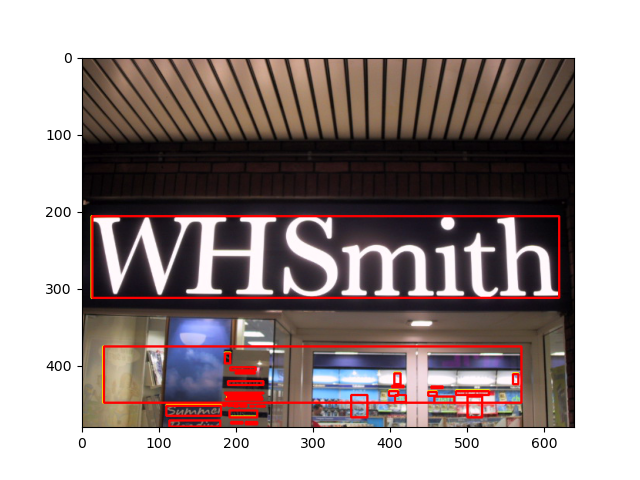

['SCOTTISH', 'NATIONAL', 'GALLERY', 'MODERN', '###', '###', '###', '###']
tensor([[0.7078, 0.0504, 0.5302, 0.1008],
        [0.6677, 0.3738, 0.5021, 0.0758],
        [0.6104, 0.6945, 0.4104, 0.0813],
        [0.6068, 0.9500, 0.4302, 0.0906],
        [0.1630, 0.6527, 0.0365, 0.0195],
        [0.1714, 0.6957, 0.0115, 0.0195],
        [0.1557, 0.6941, 0.0135, 0.0164],
        [0.1828, 0.6961, 0.0052, 0.0203]])


<IPython.core.display.Javascript object>


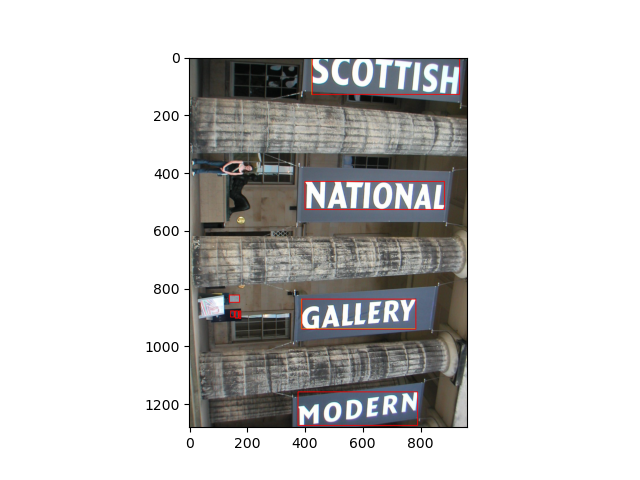

['ESSEX']
tensor([[0.4734, 0.5229, 0.7781, 0.2875]])


<IPython.core.display.Javascript object>


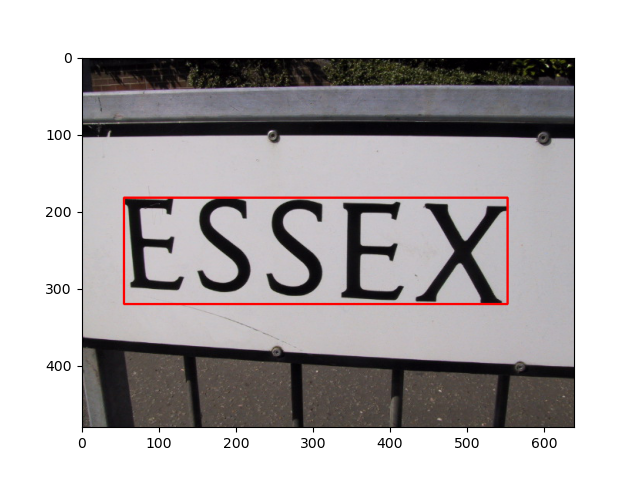

['Constantine', 'Room']
tensor([[0.4914, 0.4365, 0.7516, 0.1687],
        [0.4898, 0.6156, 0.3766, 0.1687]])


<IPython.core.display.Javascript object>


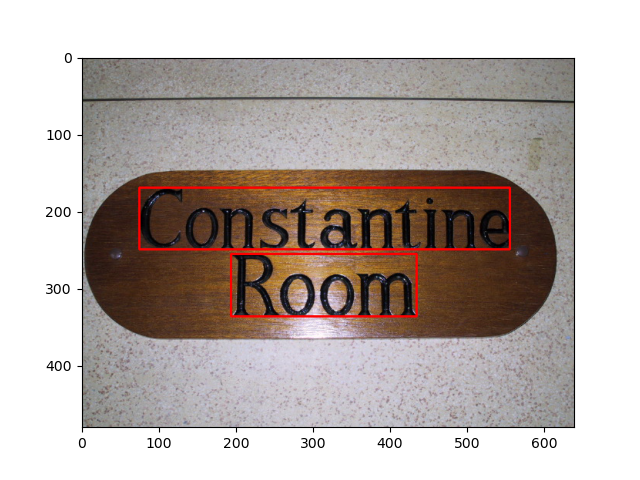

['B&H']
tensor([[0.5000, 0.5000, 0.7594, 0.2750]])


<IPython.core.display.Javascript object>


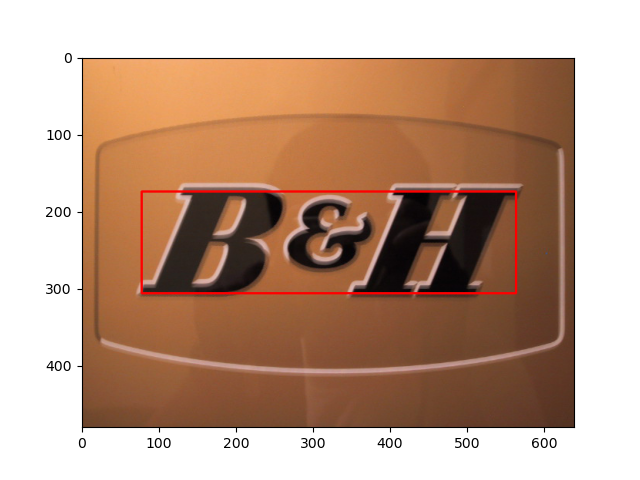

['HSBC', 'The', "world's", 'local', 'bank']
tensor([[0.3320, 0.3562, 0.5547, 0.2125],
        [0.1328, 0.5740, 0.1438, 0.0812],
        [0.3734, 0.5802, 0.2750, 0.0813],
        [0.6336, 0.5844, 0.1734, 0.0813],
        [0.8484, 0.5865, 0.1844, 0.0813]])


<IPython.core.display.Javascript object>


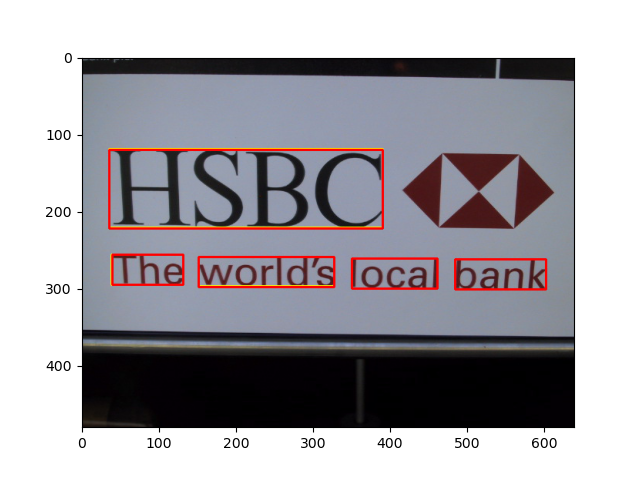

['essence', '###', 'computing', 'THE', 'ESSENCE', '###', 'ARTIFICIAL', 'INTELLIGENCE']
tensor([[0.5644, 0.0896, 0.1012, 0.0192],
        [0.6459, 0.0729, 0.0344, 0.0725],
        [0.6850, 0.1521, 0.1750, 0.0358],
        [0.2744, 0.3192, 0.0750, 0.0333],
        [0.4287, 0.3167, 0.1775, 0.0350],
        [0.5691, 0.3150, 0.0481, 0.0333],
        [0.5653, 0.4229, 0.3281, 0.0508],
        [0.5659, 0.5129, 0.3869, 0.0442]])


<IPython.core.display.Javascript object>


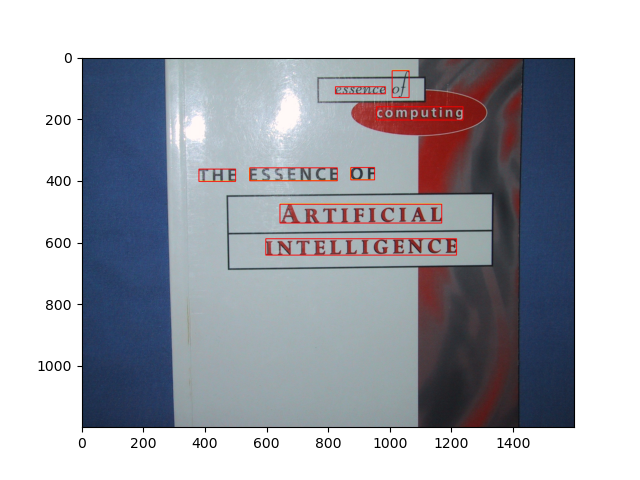

['###', '###', 'Cable', 'DLR-3P', 'A4382', 'Nokia', '6210', 'DLR-3P', 'Data', 'Cable', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', 'KIA', 'apter']
tensor([[0.4641, 0.2113, 0.0844, 0.0875],
        [0.4688, 0.3079, 0.0100, 0.0242],
        [0.5744, 0.3083, 0.0600, 0.0283],
        [0.6553, 0.3096, 0.0794, 0.0275],
        [0.4147, 0.4342, 0.0744, 0.0283],
        [0.3969, 0.4967, 0.0400, 0.0167],
        [0.3931, 0.5371, 0.0375, 0.0175],
        [0.4034, 0.5771, 0.0581, 0.0175],
        [0.4556, 0.5800, 0.0325, 0.0167],
        [0.4994, 0.5821, 0.0425, 0.0175],
        [0.7400, 0.8625, 0.1838, 0.1183],
        [0.7069, 0.9592, 0.2475, 0.0800],
        [0.7884, 0.7262, 0.0956, 0.1575],
        [0.7363, 0.4392, 0.2063, 0.1233],
        [0.6872, 0.5558, 0.2581, 0.1217],
        [0.5362, 0.7892, 0.2600, 0.1767],
        [0.6191, 0.6596, 0.2531, 0.1625],
        [0.4553, 0.9200, 0.2794, 0.1567],
        [0.3475, 0.6075, 0.2163, 0.1517],
        

<IPython.core.display.Javascript object>

['LLOYDS', 'BANK']
tensor([[0.3438, 0.8167, 0.3969, 0.1083],
        [0.7320, 0.8167, 0.3172, 0.1042]])


<IPython.core.display.Javascript object>


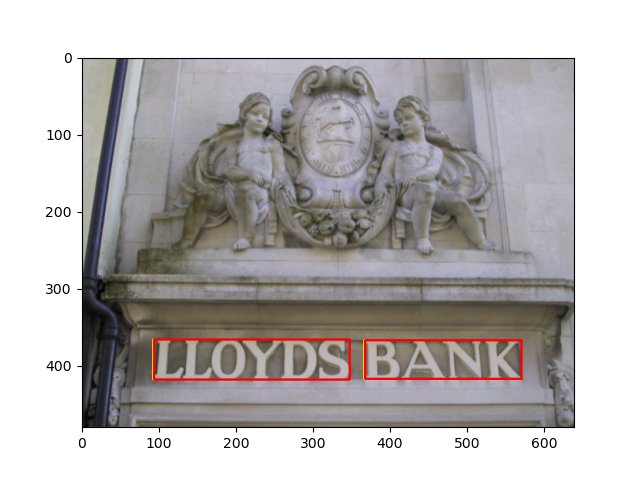

['FREE', 'DELIVERY']
tensor([[0.1969, 0.5417, 0.3156, 0.1542],
        [0.6852, 0.5573, 0.5359, 0.1521]])


<IPython.core.display.Javascript object>


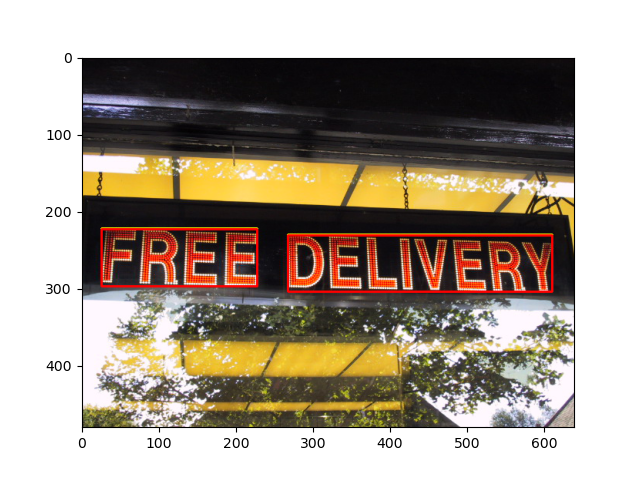

['SANYO', 'PROxtraX', 'MULTIMEDIA', 'PROJECTOR']
tensor([[0.5227, 0.1792, 0.4859, 0.2042],
        [0.5117, 0.7375, 0.4547, 0.1042],
        [0.4039, 0.8219, 0.2266, 0.0312],
        [0.6336, 0.8219, 0.2047, 0.0312]])


<IPython.core.display.Javascript object>


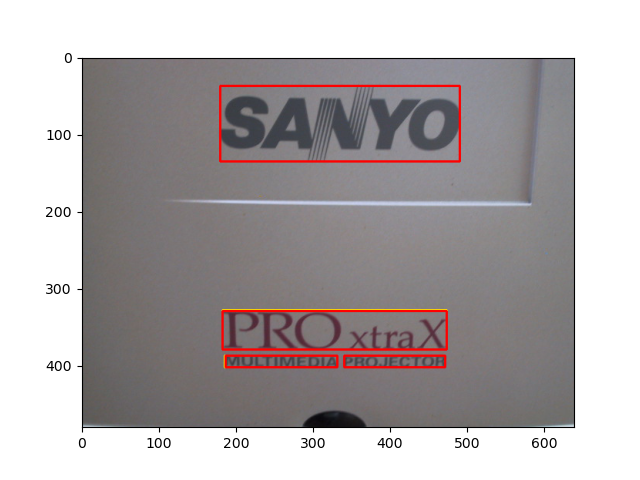

['TAXI']
tensor([[0.5070, 0.4938, 0.7172, 0.3000]])


<IPython.core.display.Javascript object>


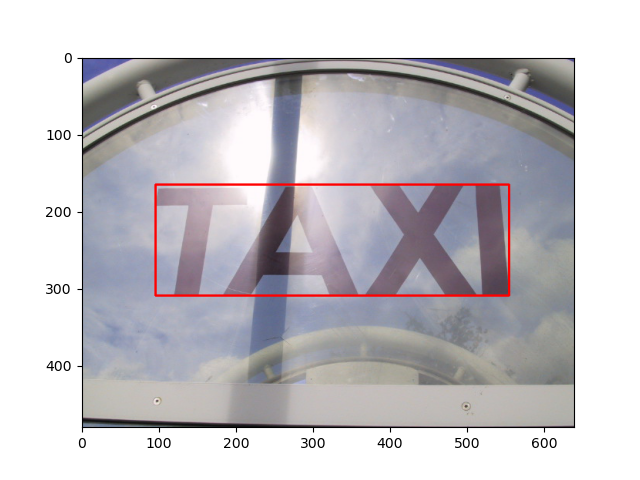

In [10]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectangleRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Born Digital Images

In [11]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARBornDigitalTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['IEEE', 'TRANSACTIONS', '###', 'COMPUTERS', 'Special', 'Section', 'System-Level', 'Design', '###', 'Reliable', 'Architectures']
tensor([[0.1622, 0.1620, 0.0978, 0.0520],
        [0.3911, 0.1720, 0.3200, 0.0400],
        [0.6044, 0.1720, 0.0489, 0.0400],
        [0.5267, 0.3140, 0.7200, 0.1400],
        [0.8189, 0.4840, 0.0822, 0.0400],
        [0.9156, 0.4800, 0.0844, 0.0320],
        [0.1744, 0.6740, 0.2556, 0.0760],
        [0.3878, 0.6740, 0.1267, 0.0760],
        [0.4867, 0.6660, 0.0311, 0.0600],
        [0.5989, 0.6660, 0.1578, 0.0600],
        [0.8211, 0.6660, 0.2511, 0.0600]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


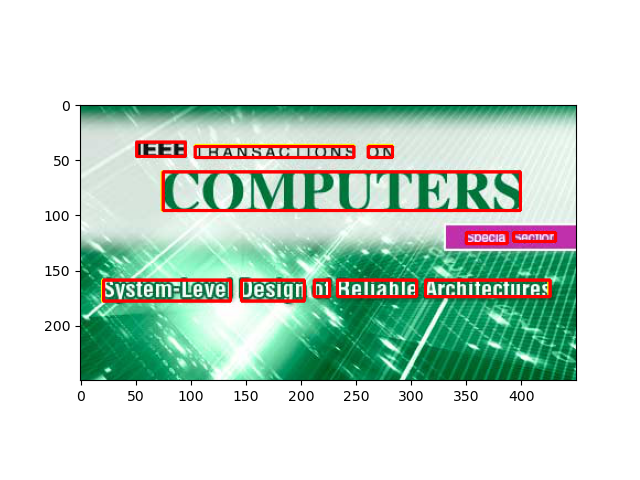

['###', 'Depth', 'JULY', '2010', '###', 'ResearcherID', 'Newsletter']
tensor([[0.0558, 0.3602, 0.0417, 0.2627],
        [0.1650, 0.3856, 0.1533, 0.3136],
        [0.5525, 0.1822, 0.0383, 0.0593],
        [0.6000, 0.1822, 0.0400, 0.0593],
        [0.0400, 0.7076, 0.0167, 0.1102],
        [0.1642, 0.7119, 0.2017, 0.1186],
        [0.3600, 0.7076, 0.1600, 0.1102]])


<IPython.core.display.Javascript object>


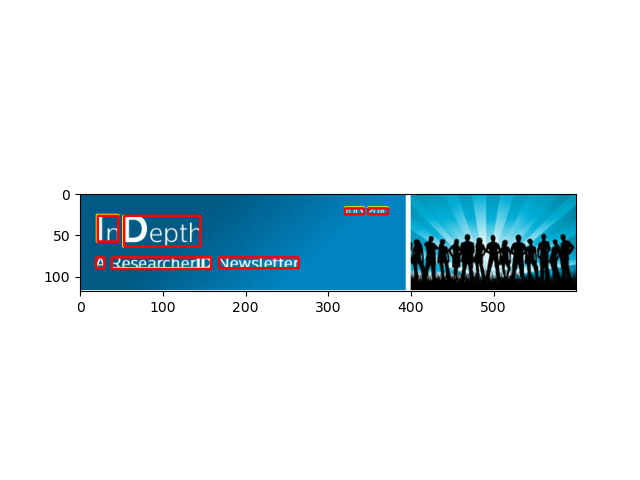

['###', 'Disney', 'PIXAR']
tensor([[0.8511, 0.1502, 0.2241, 0.1917],
        [0.8965, 0.0719, 0.0397, 0.0415],
        [0.9418, 0.0687, 0.0340, 0.0160]])


<IPython.core.display.Javascript object>


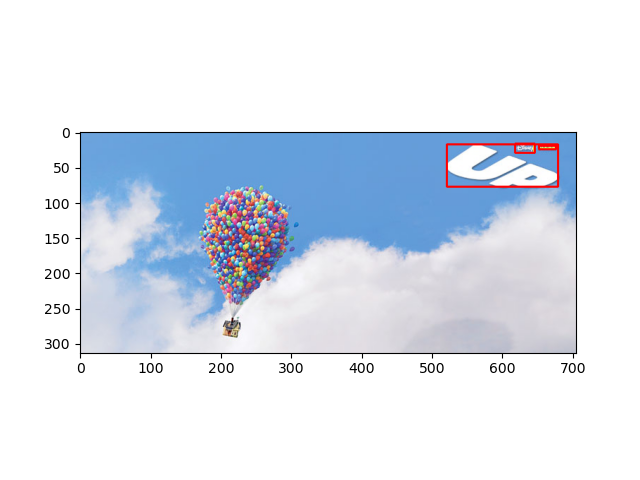

['Forbes', 'Featured', 'Articles', 'Learn', 'more']
tensor([[0.4897, 0.4216, 0.9136, 0.4104],
        [0.1708, 0.7090, 0.1770, 0.0746],
        [0.3436, 0.7127, 0.1523, 0.0672],
        [0.6893, 0.7201, 0.1111, 0.0672],
        [0.8086, 0.7239, 0.1029, 0.0597]])


<IPython.core.display.Javascript object>


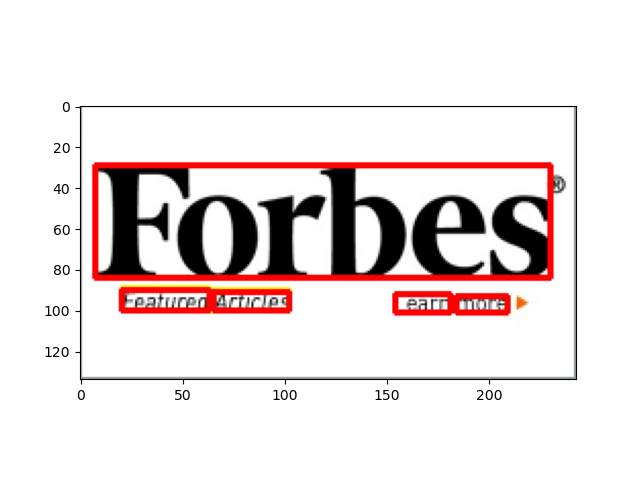

['PREMIER', 'APARTMENTS']
tensor([[0.4992, 0.7039, 0.0938, 0.1068],
        [0.4992, 0.8883, 0.0969, 0.1068]])


<IPython.core.display.Javascript object>


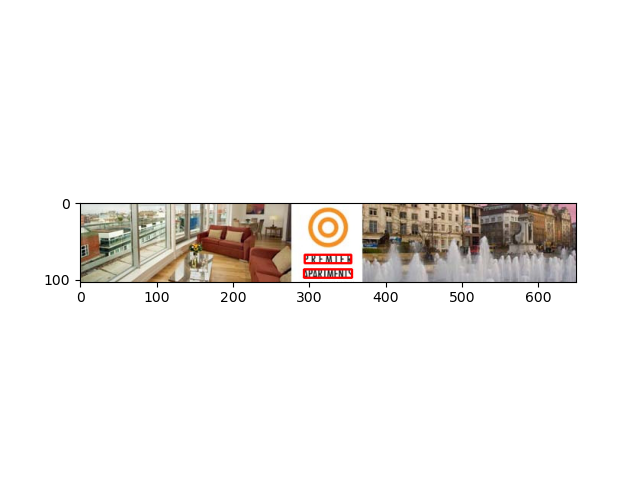

['NEWCASTLE', 'UNITED', 'nufc.co.uk', 'THE', 'OFFICIAL', 'CLUB', 'SITE', 'ENTER', 'SITE']
tensor([[0.4102, 0.4954, 0.2934, 0.0396],
        [0.6527, 0.4939, 0.1796, 0.0366],
        [0.5030, 0.5854, 0.6467, 0.0488],
        [0.2156, 0.6296, 0.0958, 0.0152],
        [0.4132, 0.6296, 0.2275, 0.0152],
        [0.6257, 0.6296, 0.1257, 0.0152],
        [0.7754, 0.6296, 0.1018, 0.0152],
        [0.3623, 0.6707, 0.3653, 0.0366],
        [0.7096, 0.6707, 0.2216, 0.0366]])


<IPython.core.display.Javascript object>


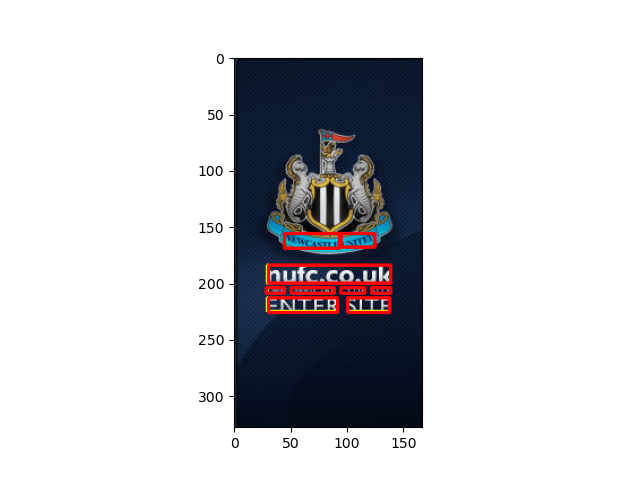

['ENTERPRISE', 'COLLABORATION', 'SEE', '###', 'AND', 'CONTROL', '###', 'BEYOND', 'THE', 'FIREWALL', 'Akamai']
tensor([[0.1692, 0.3571, 0.2441, 0.1607],
        [0.4933, 0.3571, 0.3636, 0.1607],
        [0.0766, 0.6339, 0.0623, 0.1607],
        [0.1423, 0.6384, 0.0421, 0.0089],
        [0.2189, 0.6339, 0.0808, 0.1607],
        [0.3662, 0.6339, 0.1835, 0.1607],
        [0.4924, 0.6384, 0.0421, 0.0089],
        [0.6069, 0.6339, 0.1566, 0.1607],
        [0.0791, 0.9062, 0.0707, 0.1518],
        [0.2231, 0.9062, 0.1835, 0.1518],
        [0.8855, 0.5312, 0.1347, 0.1339]])


<IPython.core.display.Javascript object>


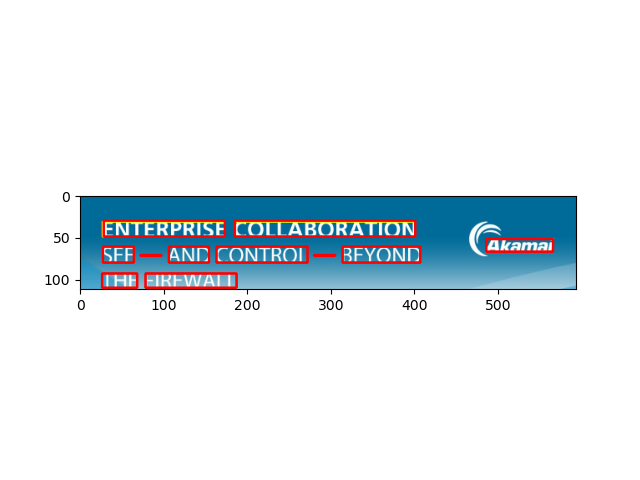

['Join', '###']
tensor([[0.1375, 0.7400, 0.0850, 0.2533],
        [0.1350, 0.5033, 0.0800, 0.0867]])


<IPython.core.display.Javascript object>


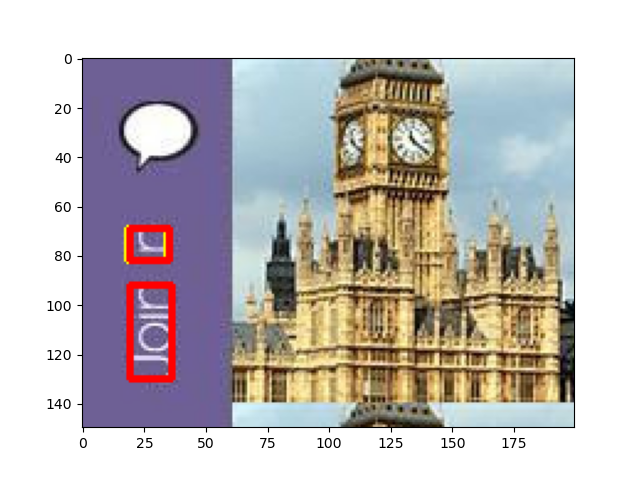

['###', 'DIGITAL', 'LIBRARY', 'Authoritative.', 'Cutting', 'Edge.', 'Comprehensive.', 'Find', 'out', 'more.']
tensor([[0.0860, 0.2380, 0.1240, 0.0600],
        [0.3540, 0.2380, 0.3560, 0.0600],
        [0.7740, 0.2380, 0.4040, 0.0600],
        [0.4040, 0.4280, 0.6720, 0.0800],
        [0.2400, 0.5840, 0.3440, 0.1040],
        [0.6100, 0.5840, 0.2680, 0.1040],
        [0.4640, 0.7280, 0.7920, 0.1040],
        [0.4260, 0.8760, 0.1320, 0.0560],
        [0.5800, 0.8820, 0.0960, 0.0440],
        [0.7560, 0.8860, 0.1840, 0.0360]])


<IPython.core.display.Javascript object>


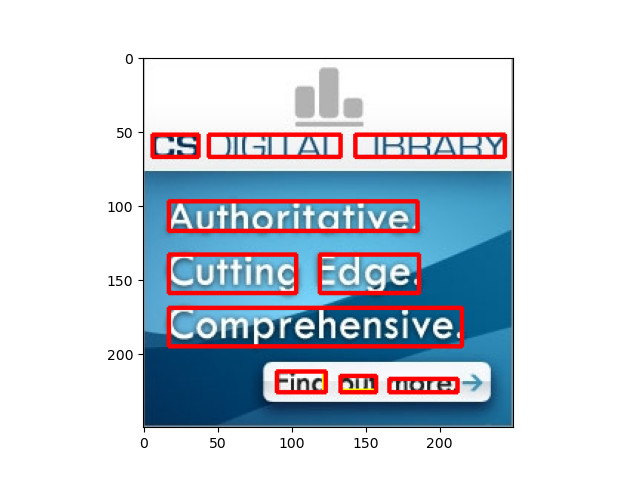

['TESCO', 'mobile', 'Double', 'Value', 'Top', 'Ups', 'ALWAYS', '###']
tensor([[0.4690, 0.4312, 0.3643, 0.0734],
        [0.4690, 0.5780, 0.2713, 0.0917],
        [0.2093, 0.7431, 0.2326, 0.0550],
        [0.4457, 0.7431, 0.1783, 0.0550],
        [0.6240, 0.7523, 0.1163, 0.0734],
        [0.7713, 0.7523, 0.1163, 0.0734],
        [0.4651, 0.8532, 0.2636, 0.0550],
        [0.9070, 0.8807, 0.0930, 0.0550]])


<IPython.core.display.Javascript object>

['THE', 'RECOVERY', 'ACT', 'ROAD', 'MAP', '###', 'RECOVERY']
tensor([[0.2273, 0.1043, 0.1273, 0.0647],
        [0.5055, 0.1079, 0.3564, 0.0719],
        [0.7764, 0.1079, 0.1273, 0.0719],
        [0.3145, 0.3453, 0.2582, 0.1151],
        [0.5564, 0.3417, 0.1964, 0.1079],
        [0.7509, 0.3453, 0.1273, 0.1151],
        [0.5036, 0.5216, 0.7309, 0.1655]])


<IPython.core.display.Javascript object>

['COSFORD', 'LONDON']
tensor([[0.6974, 0.3116, 0.2579, 0.0580],
        [0.5895, 0.5978, 0.2316, 0.0652]])


<IPython.core.display.Javascript object>

['Springer', 'NEW', 'BOOK', 'ALERT']
tensor([[0.1797, 0.3456, 0.1531, 0.2059],
        [0.0797, 0.8309, 0.0781, 0.1176],
        [0.1828, 0.8272, 0.0969, 0.1250],
        [0.3000, 0.8272, 0.1094, 0.1250]])


<IPython.core.display.Javascript object>


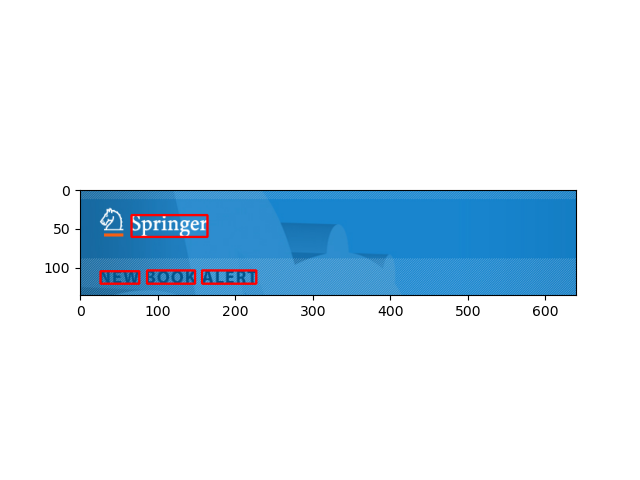

['200', 'Days', 'Web', 'Retention', '650', 'Days', 'NNTP', 'Retention', 'Free', '256-Bit', 'Encrypted', 'SSL', 'Unlimited', 'Connections', 'Rollover', 'Gigs', 'SIGN', '###', 'TODAY!', '###']
tensor([[0.2476, 0.0737, 0.1327, 0.0553],
        [0.3964, 0.0829, 0.1133, 0.0737],
        [0.5259, 0.0737, 0.1068, 0.0645],
        [0.7168, 0.0760, 0.2298, 0.0599],
        [0.2282, 0.2051, 0.0939, 0.0599],
        [0.3544, 0.2097, 0.1133, 0.0691],
        [0.5032, 0.2028, 0.1327, 0.0553],
        [0.7071, 0.2028, 0.2298, 0.0553],
        [0.2330, 0.3318, 0.0971, 0.0553],
        [0.3981, 0.3341, 0.1877, 0.0599],
        [0.6327, 0.3387, 0.2362, 0.0783],
        [0.8155, 0.3318, 0.0777, 0.0553],
        [0.2977, 0.4585, 0.2330, 0.0599],
        [0.5922, 0.4608, 0.3042, 0.0553],
        [0.2816, 0.5876, 0.1942, 0.0599],
        [0.4498, 0.5991, 0.1036, 0.0737],
        [0.3042, 0.8180, 0.1359, 0.0599],
        [0.4385, 0.8180, 0.0744, 0.0599],
        [0.6068, 0.8180, 0.2233, 0.0599],
        [0.

<IPython.core.display.Javascript object>


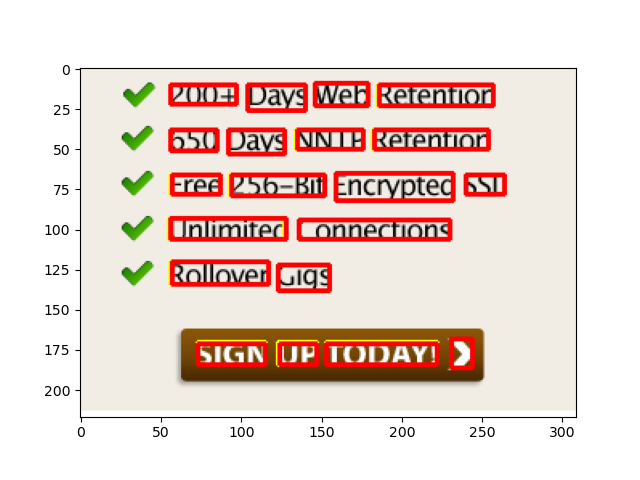

['expansys']
tensor([[0.5380, 0.5725, 0.4321, 0.6260]])


<IPython.core.display.Javascript object>


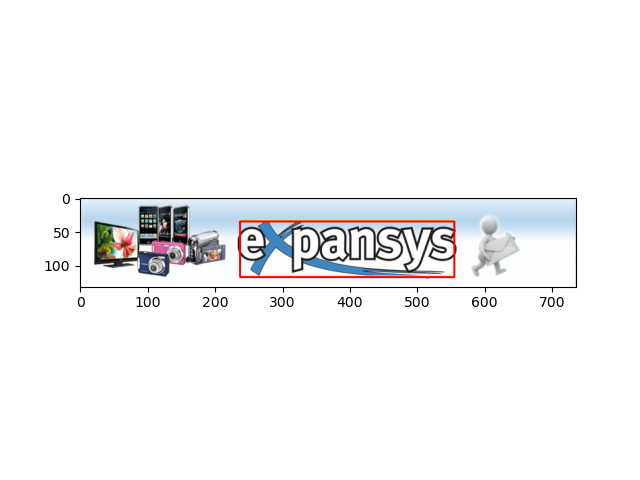

In [12]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectangleRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)